<a href="https://colab.research.google.com/github/harshitharavi26/PP2/blob/main/Project_Phase_2_Prototypical.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###**Setting up the colab to make it compatible to the framework**

In [ ]:
import os
import torch

In [ ]:
#Setting environment variables using os.environ. This is done before initializing TensorFlow to limit TensorFlow to first GPU.
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [ ]:
#displays the installed GPU stats
!nvidia-smi

Tue Feb 16 06:25:41 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

####**Installing the compatible CUDA version**

In [ ]:
#Checking the current CUDA compiler version
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Sun_Jul_28_19:07:16_PDT_2019
Cuda compilation tools, release 10.1, V10.1.243


In [ ]:
#Uninstall the current CUDA version
!apt-get --purge remove cuda nvidia* libnvidia-*
!dpkg -l | grep cuda- | awk '{print $2}' | xargs -n1 dpkg --purge
!apt-get remove cuda-*
!apt autoremove
!apt-get update

Reading package lists... Done
Building dependency tree       
Reading state information... Done
Note, selecting 'nvidia-kernel-common-418-server' for glob 'nvidia*'
Note, selecting 'nvidia-325-updates' for glob 'nvidia*'
Note, selecting 'nvidia-346-updates' for glob 'nvidia*'
Note, selecting 'nvidia-driver-binary' for glob 'nvidia*'
Note, selecting 'nvidia-331-dev' for glob 'nvidia*'
Note, selecting 'nvidia-304-updates-dev' for glob 'nvidia*'
Note, selecting 'nvidia-compute-utils-418-server' for glob 'nvidia*'
Note, selecting 'nvidia-384-dev' for glob 'nvidia*'
Note, selecting 'nvidia-libopencl1-346-updates' for glob 'nvidia*'
Note, selecting 'nvidia-driver-440-server' for glob 'nvidia*'
Note, selecting 'nvidia-340-updates-uvm' for glob 'nvidia*'
Note, selecting 'nvidia-dkms-450-server' for glob 'nvidia*'
Note, selecting 'nvidia-kernel-common' for glob 'nvidia*'
Note, selecting 'nvidia-kernel-source-440-server' for glob 'nvidia*'
Note, selecting 'nvidia-331-updates-uvm' for glob 'nvidi

In [ ]:
#Downloading CUDA 10.0
!wget  --no-clobber https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
#Installing CUDA kit dpkg
!dpkg -i cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
!sudo apt-key adv --fetch-keys https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/7fa2af80.pub
!apt-get update
!apt-get install cuda-10-0

--2021-02-16 06:26:55--  https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
Resolving developer.download.nvidia.com (developer.download.nvidia.com)... 152.195.19.142
Connecting to developer.download.nvidia.com (developer.download.nvidia.com)|152.195.19.142|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2940 (2.9K) [application/x-deb]
Saving to: ‘cuda-repo-ubuntu1804_10.0.130-1_amd64.deb’

cuda-repo-ubuntu180 100%[===================>]   2.87K  --.-KB/s    in 0s      

2021-02-16 06:26:55 (158 MB/s) - ‘cuda-repo-ubuntu1804_10.0.130-1_amd64.deb’ saved [2940/2940]

Selecting previously unselected package cuda-repo-ubuntu1804.
(Reading database ... 124197 files and directories currently installed.)
Preparing to unpack cuda-repo-ubuntu1804_10.0.130-1_amd64.deb ...
Unpacking cuda-repo-ubuntu1804 (10.0.130-1) ...
Setting up cuda-repo-ubuntu1804 (10.0.130-1) ...

Configuration file '/etc/apt/sources.li

In [ ]:
#After changing version of CUDA from 10.2 to 10.0
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2018 NVIDIA Corporation
Built on Sat_Aug_25_21:08:01_CDT_2018
Cuda compilation tools, release 10.0, V10.0.130


In [ ]:
#To determine if our system supports CUDA
torch.cuda.is_available()

True

In [ ]:
#To determine the version of cuDNN
torch.backends.cudnn.version()

7603

In [ ]:
#To check if CUDNN is currently available.
torch.backends.cudnn.is_available()

True

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import os
import cv2

import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
#Setting environment variables using os.environ. This is done before initializing TensorFlow to limit TensorFlow to first GPU.
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [ ]:
#displays the installed GPU stats
!nvidia-smi

Mon Feb 15 13:22:59 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#Checking the current CUDA compiler version
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Sun_Jul_28_19:07:16_PDT_2019
Cuda compilation tools, release 10.1, V10.1.243


In [ ]:
#Uninstall the current CUDA version
!apt-get --purge remove cuda nvidia* libnvidia-*
!dpkg -l | grep cuda- | awk '{print $2}' | xargs -n1 dpkg --purge
!apt-get remove cuda-*
!apt autoremove
!apt-get update

Reading package lists... Done
Building dependency tree       
Reading state information... Done
Note, selecting 'nvidia-kernel-common-418-server' for glob 'nvidia*'
Note, selecting 'nvidia-325-updates' for glob 'nvidia*'
Note, selecting 'nvidia-346-updates' for glob 'nvidia*'
Note, selecting 'nvidia-driver-binary' for glob 'nvidia*'
Note, selecting 'nvidia-331-dev' for glob 'nvidia*'
Note, selecting 'nvidia-304-updates-dev' for glob 'nvidia*'
Note, selecting 'nvidia-compute-utils-418-server' for glob 'nvidia*'
Note, selecting 'nvidia-384-dev' for glob 'nvidia*'
Note, selecting 'nvidia-libopencl1-346-updates' for glob 'nvidia*'
Note, selecting 'nvidia-driver-440-server' for glob 'nvidia*'
Note, selecting 'nvidia-340-updates-uvm' for glob 'nvidia*'
Note, selecting 'nvidia-dkms-450-server' for glob 'nvidia*'
Note, selecting 'nvidia-kernel-common' for glob 'nvidia*'
Note, selecting 'nvidia-kernel-source-440-server' for glob 'nvidia*'
Note, selecting 'nvidia-331-updates-uvm' for glob 'nvidi

In [ ]:
#Downloading CUDA 10.0
!wget  --no-clobber https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
#Installing CUDA kit dpkg
!dpkg -i cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
!sudo apt-key adv --fetch-keys https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/7fa2af80.pub
!apt-get update
!apt-get install cuda-10-0

--2021-02-15 13:23:46--  https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
Resolving developer.download.nvidia.com (developer.download.nvidia.com)... 152.195.19.142
Connecting to developer.download.nvidia.com (developer.download.nvidia.com)|152.195.19.142|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2940 (2.9K) [application/x-deb]
Saving to: ‘cuda-repo-ubuntu1804_10.0.130-1_amd64.deb’

cuda-repo-ubuntu180 100%[===================>]   2.87K  --.-KB/s    in 0s      

2021-02-15 13:23:47 (180 MB/s) - ‘cuda-repo-ubuntu1804_10.0.130-1_amd64.deb’ saved [2940/2940]

Selecting previously unselected package cuda-repo-ubuntu1804.
(Reading database ... 124197 files and directories currently installed.)
Preparing to unpack cuda-repo-ubuntu1804_10.0.130-1_amd64.deb ...
Unpacking cuda-repo-ubuntu1804 (10.0.130-1) ...
Setting up cuda-repo-ubuntu1804 (10.0.130-1) ...

Configuration file '/etc/apt/sources.li

In [ ]:
#After changing version of CUDA from 10.2 to 10.0
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2018 NVIDIA Corporation
Built on Sat_Aug_25_21:08:01_CDT_2018
Cuda compilation tools, release 10.0, V10.0.130


In [ ]:
#Check GPU support, please do activate GPU
print(torch.cuda.is_available())

True


In [ ]:
#To determine the version of cuDNN
torch.backends.cudnn.version()

7603

In [ ]:
#To check if CUDNN is currently available.
torch.backends.cudnn.is_available()

True

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2

In [ ]:
def read_alphabets(alphabet_directory_path, alphabet_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    datax = []
    datay = []
    characters = os.listdir(alphabet_directory_path)
    print(characters)
    for character in characters:
        images = os.listdir(alphabet_directory_path + character + '/')
        for img in images:
          if (int(img.split(".")[0])<31):
            image = cv2.resize(
                cv2.imread(alphabet_directory_path + character + '/' + img),
                (256,256)
                )
            #rotations of image
            rotated_90 = ndimage.rotate(image, 90)
            rotated_180 = ndimage.rotate(image, 180)
            rotated_270 = ndimage.rotate(image, 270)
            datax.extend((image, rotated_90, rotated_180, rotated_270))
            datay.extend((
                alphabet_directory_name + '_' + img + '_0',
                alphabet_directory_name + '_' + img + '_90',
                alphabet_directory_name + '_' + img + '_180',
                alphabet_directory_name + '_' + img + '_270'
            ))
    return np.array(datax), np.array(datay)

In [ ]:
def read_alphabets(alphabet_directory_path, alphabet_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    datax = []
    datay = []
    images = os.listdir(alphabet_directory_path)
    for img in images:
      if (int(img.split(".")[0])<31):
        image = cv2.resize(
            cv2.imread(alphabet_directory_path+img),
            (256,256)
             )
            #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        #print(type(rotated_90))
        #print(rotated_90.shape)
        rotated_180 = ndimage.rotate(image, 180)
        #print(rotated_180)
        rotated_270 = ndimage.rotate(image, 270)
        #print(datax)
        datax.extend((image, rotated_90, rotated_180, rotated_270))
        #print(datax)  
        """datay.extend((
                alphabet_directory_name + '_' + img + '_0',
                alphabet_directory_name + '_' + img + '_90',
                alphabet_directory_name + '_' + img + '_180',
                alphabet_directory_name + '_' + img + '_270'
            ))"""
        datay.extend((
                alphabet_directory_name + '_0',
                alphabet_directory_name + '_90',
                alphabet_directory_name + '_180',
                alphabet_directory_name + '_270'
            ))
    #print(datax)
    #print(datay)
    return np.array(datax), np.array(datay)

In [ ]:
def read_images(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    datax = None
    datay = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_alphabets,
                          args=(
                              base_directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    print(results)
    print(len(results[0]))
    for result in results:
        if datax is None:
            datax = result[0]
            datay = result[1]
        else:
            datax = np.vstack([datax, result[0]])
            datay = np.concatenate([datay, result[1]])
    return datax, datay

In [ ]:
def read_images(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    datax = None
    datay = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_alphabets,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if datax is None:
            datax = result[0]
            datay = result[1]
        else:
            datax = np.vstack([datax, result[0]])
            datay = np.concatenate([datay, result[1]])
    return datax, datay

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions'

In [ ]:
%%time
trainx, trainy = read_images(dir)
#trainx, test_x, trainy, test_y = train_test_split(X, Y, test_size=.25,random_state=42)

CPU times: user 131 ms, sys: 176 ms, total: 307 ms
Wall time: 55.8 s


In [ ]:
trainx.shape, trainy.shape

((600, 256, 256, 3), (600,))

In [ ]:
def extract_sample(n_way, n_support, n_query, datax, datay):
  """
  Picks random sample of size n_support+n_querry, for n_way classes
  Args:
      n_way (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      datax (np.array): dataset of images
      datay (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_way, n_support+n_query, (dim))
        (int): n_way
        (int): n_support
        (int): n_query
  """
  sample = []
  K = np.random.choice(np.unique(datay), n_way, replace=False)
  for cls in K:
    datax_cls = datax[datay == cls]
    perm = np.random.permutation(datax_cls)
    sample_cls = perm[:(n_support+n_query)]
    sample.append(sample_cls)
  print("sample1=",sample)
  sample = np.array(sample,dtype=np.float)
  print(sample.shape)
  print(sample.dtype)
  print("sample2=",sample)
  #sample= np.vstack(sample)#.astype(np.float)
  print(sample.shape)
  print("sample3=",sample)
  sample = torch.from_numpy(sample).float()
  print("sample4=",sample)
  print(sample.shape)

  sample = sample.permute(0,1,4,2,3)
  return({
      'images': sample,
      'n_way': n_way,
      'n_support': n_support,
      'n_query': n_query
      })

In [ ]:
def extract_sample(n_way, n_support, n_query, datax, datay):
  """
  Picks random sample of size n_support+n_querry, for n_way classes
  Args:
      n_way (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      datax (np.array): dataset of images
      datay (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_way, n_support+n_query, (dim))
        (int): n_way
        (int): n_support
        (int): n_query
  """
  sample = []
  K = np.random.choice(np.unique(datay), n_way, replace=False)
  for cls in K:
    datax_cls = datax[datay == cls]
    perm = np.random.permutation(datax_cls)
    sample_cls = perm[:(n_support+n_query)]
    sample.append(sample_cls)
  sample = np.array(sample)
  sample = torch.from_numpy(sample).float()
  sample = sample.permute(0,1,4,2,3)
  #print(sample.shape)
  #print(sample)
  return({
      'images': sample,
      'n_way': n_way,
      'n_support': n_support,
      'n_query': n_query
      })

In [ ]:
def display_sample(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1])
  plt.figure(figsize = (16,7))
  plt.imshow(out.permute(1, 2, 0))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


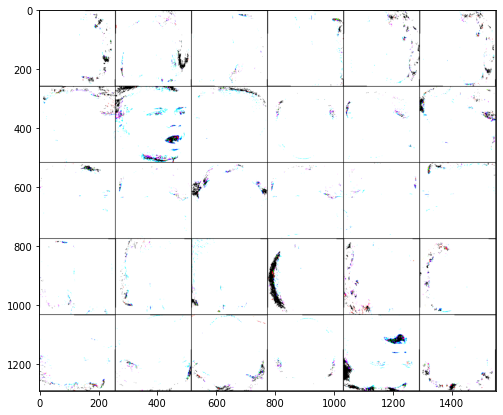

In [ ]:
sample_example = extract_sample(5, 3, 3, trainx, trainy)
display_sample(sample_example['images'])

In [ ]:

sample_example['images'].shape

torch.Size([5, 6, 3, 256, 256])

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
    
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim),
    conv_block(hid_dim, hid_dim),
    conv_block(hid_dim, hid_dim),
    conv_block(hid_dim, z_dim),
    Flatten()
    )
    
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_way (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_way, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_way = sample['n_way']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]
    x_query = sample_images[:, n_support:]
   
    #target indices are 0 ... n_way-1
    target_inds = torch.arange(0, n_way).view(n_way, 1, 1).expand(n_way, n_query, 1).long()
    target_inds = Variable(target_inds, requires_grad=False)
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_way * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_way * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_way*n_support].view(n_way, n_support, z_dim).mean(1)
    z_query = z[n_way*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_way, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_way*n_query
      y (torch.Tensor): shape (m, d). m usually n_way
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_way, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_way (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      sample = extract_sample(n_way, n_support, n_query, train_x, train_y)
      optimizer.zero_grad()
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,28,28),
    hid_dim=64,
    z_dim=64,
    )

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_way = 5
n_support = 2
n_query = 2

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 2000

train(model, optimizer, train_x, train_y, n_way, n_support, n_query, max_epoch, epoch_size)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:24: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 10.1858 Acc: 0.6735



Epoch 2 -- Loss: 0.5353 Acc: 0.7238



Epoch 3 -- Loss: 0.4662 Acc: 0.7735



Epoch 4 -- Loss: 0.3693 Acc: 0.8322



Epoch 5 -- Loss: 0.3226 Acc: 0.8567
CPU times: user 8min 40s, sys: 4min 15s, total: 12min 55s
Wall time: 12min 54s


Testing


In [ ]:
def read_alphabets1(alphabet_directory_path, alphabet_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    datax = []
    datay = []
    images = os.listdir(alphabet_directory_path)
    for img in images:
      if (int(img.split(".")[0])>30):
        image = cv2.resize(
            cv2.imread(alphabet_directory_path+img),
            (256,256)
             )
            #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        #print(type(rotated_90))
        #print(rotated_90.shape)
        rotated_180 = ndimage.rotate(image, 180)
        #print(rotated_180)
        rotated_270 = ndimage.rotate(image, 270)
        #print(datax)
        datax.extend((image, rotated_90, rotated_180, rotated_270))
        #print(datax)  
        """datay.extend((
                alphabet_directory_name + '_' + img + '_0',
                alphabet_directory_name + '_' + img + '_90',
                alphabet_directory_name + '_' + img + '_180',
                alphabet_directory_name + '_' + img + '_270'
            ))"""
        datay.extend((
                alphabet_directory_name + '_0',
                alphabet_directory_name + '_90',
                alphabet_directory_name + '_180',
                alphabet_directory_name + '_270'
            ))
    #print(datax)
    #print(datay)
    return np.array(datax), np.array(datay)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    datax = None
    datay = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_alphabets1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if datax is None:
            datax = result[0]
            datay = result[1]
        else:
            datax = np.vstack([datax, result[0]])
            datay = np.concatenate([datay, result[1]])
    return datax, datay

In [ ]:
#Test data
%%time 
testx, testy = read_images1(dir)

CPU times: user 57.3 ms, sys: 125 ms, total: 183 ms
Wall time: 20.4 s


In [ ]:
print(testx.shape, testy.shape)

(220, 256, 256, 3) (220,)


In [ ]:
def test(model, test_x, test_y, n_way, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_way (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_sample(n_way, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

In [ ]:
n_way = 5
n_support = 3
n_query = 3

test_x = testx
test_y = testy

test_episode = 1000

test(model, test_x, test_y, n_way, n_support, n_query, test_episode)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 0.3805 Acc: 0.8205


Testing with a sample

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


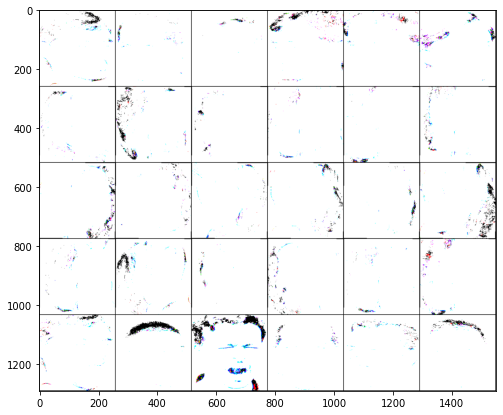

In [ ]:
my_sample = extract_sample(n_way, n_support, n_query, test_x, test_y)
display_sample(my_sample['images'])

In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.8666667342185974,
 'loss': 0.27835050225257874,
 'y_hat': tensor([[0, 0, 0],
         [1, 1, 3],
         [2, 2, 2],
         [3, 3, 3],
         [4, 0, 4]], device='cuda:0')}

In [ ]:
# Saving the model
torch.save(model, "/content/drive/MyDrive/ProjectPhase/firstprotonet.pth")

In [ ]:
#Loading the model
model = torch.load("/content/drive/MyDrive/ProjectPhase/firstprotonet.pth")
model.eval()

AttributeError: ignored

In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.8666667342185974,
 'loss': 0.2691683769226074,
 'y_hat': tensor([[0, 0, 0],
         [1, 1, 3],
         [2, 2, 2],
         [3, 3, 3],
         [4, 0, 4]], device='cuda:0')}

# **Prototypical Network with 5 classes**


##Importing

Pytorch, Numpy

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in e1
      if (int(img.split(".")[0])<31):#Take only 30 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
        data.append(image)
        labels.append(emotion_directory_name)

        """#Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))"""
        
    # All images in e1 rotated at 90 will have the label e1_90
    # Hence every emotion(e1,e2,e3,e4,e5) will have 4 different classes
    # 5 emotions * 4 classes per emotion = 20 classes
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            #array([[...],[...],[...]])
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions'

In [ ]:
%%time
trainx, trainy = read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 38.3 ms, sys: 71.1 ms, total: 109 ms
Wall time: 45.4 s


In [ ]:
trainx.shape, trainy.shape
#20 classes * 30 images per class = 600 images

((150, 256, 256, 3), (150,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

['e5', 'e3', 'e2', 'e4', 'e1']


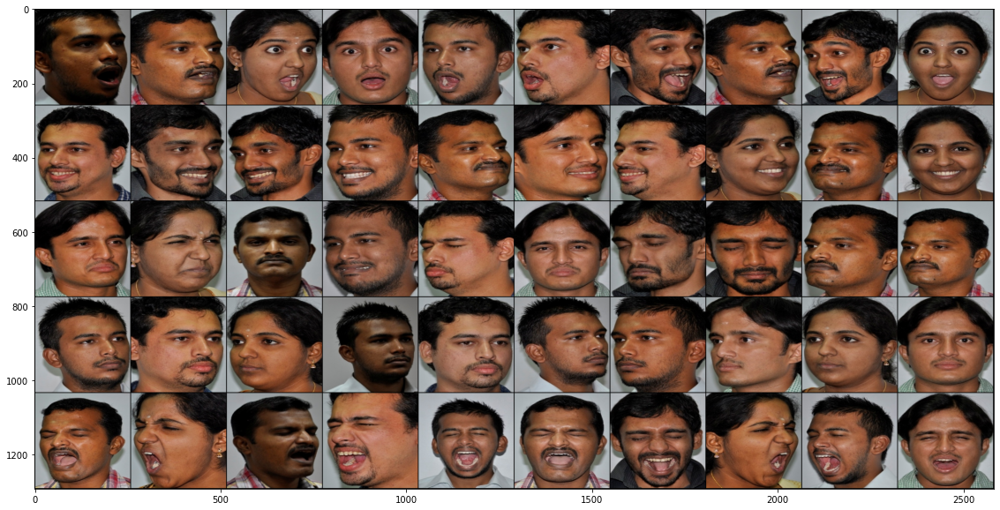

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. you pass your images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of your vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 4.3259 Acc: 0.8064



Epoch 2 -- Loss: 0.0369 Acc: 0.9889



Epoch 3 -- Loss: 0.0003 Acc: 0.9999
CPU times: user 12min 6s, sys: 7min 34s, total: 19min 40s
Wall time: 19min 44s


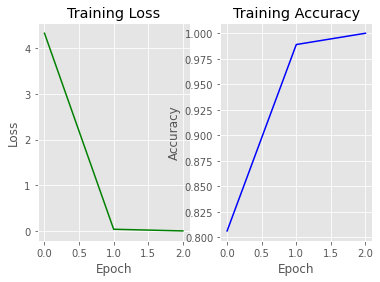

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #ddimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 5
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 1000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_5class_5ns_5nq.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_5class_3ns_3nq.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      if (int(img.split(".")[0])>30):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
        data.append(image)
        labels.append(emotion_directory_name)
        """    #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))"""
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 18.7 ms, sys: 84.5 ms, total: 103 ms
Wall time: 19.9 s


In [ ]:
testx.shape,testy.shape

((55, 256, 256, 3), (55,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

In [ ]:
n_classes = 5
n_support = 7
n_query = 3

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 1.1994 Acc: 0.7328



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    #print(sample_cls.shape)
    sample_cls1=np.concatenate((sample_cls, query))
    #print(sample_cls1.shape)
    sample.append(sample_cls1)
    #print(sample.shape)
    # sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e1":"Anger","e2":"Disgust","e3":"Happy","e4":"Neutral","e5":"Surprise"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


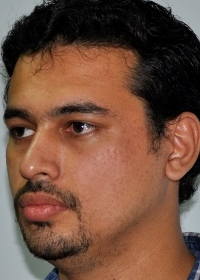

In [ ]:
#from IPython.display import Image
test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e4/38.jpg'
display(Image(test_image_path))

In [ ]:
test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e4/38.jpg'
Image.open(test_image_path)

AttributeError: ignored

torch.Size([5, 4, 3, 256, 256])


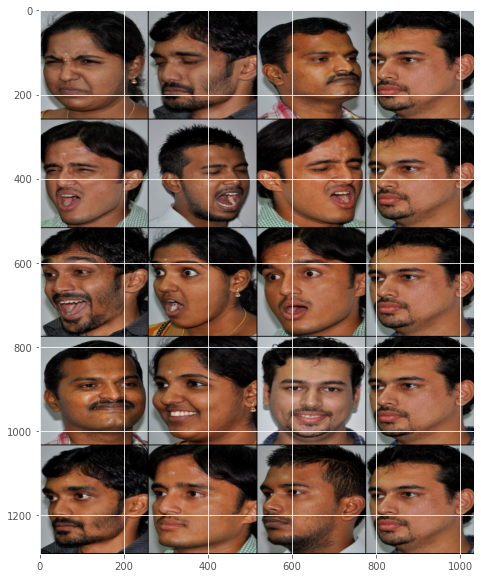

In [ ]:
query = read_test_image(test_image_path)
example1 = extract_image2(5, 3, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Neutral


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=['Anger', 'Disgust', 'Happy', 'Neutral', 'Surprise']
  PCLASSES=['Surprise', 'Neutral', 'Happy', 'Disgust', 'Anger']
  list_acc=[[0 for i in range(5)] for j in range(5)]
  list_dict={"Anger":1,"Disgust":2,"Happy":3,"Neutral":4,"Surprise":5}
  for i in range(5):
    for j in range(31,41):
      test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e'+str(i+1)+'/'+str(j)+'.jpg'
      test_query = read_test_image(test_image_path)
      test_example1 = extract_image2(5, 5, test_query, testx, testy)
      prediction=predict_test(test_example1)
      pred=list_dict[prediction]
      list_acc[i][pred-1]+=1
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/10 for i in range(5)] for j in range(5)]
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


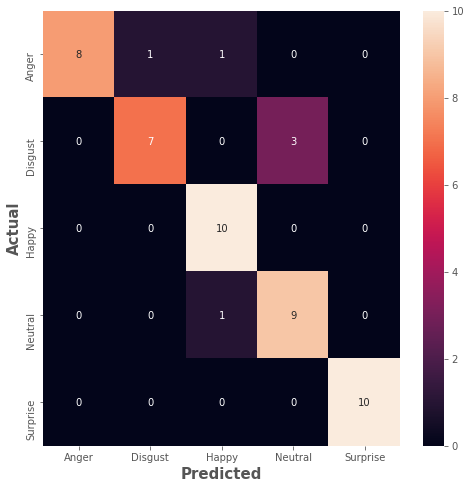

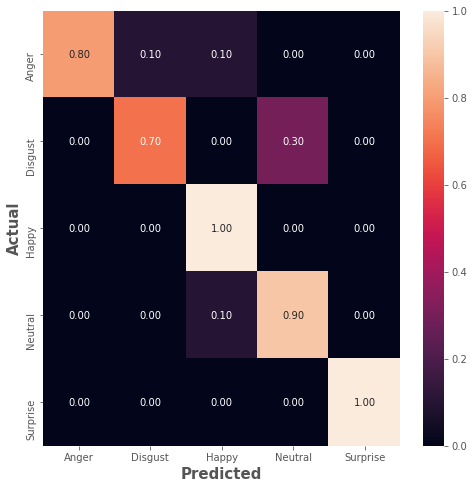

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


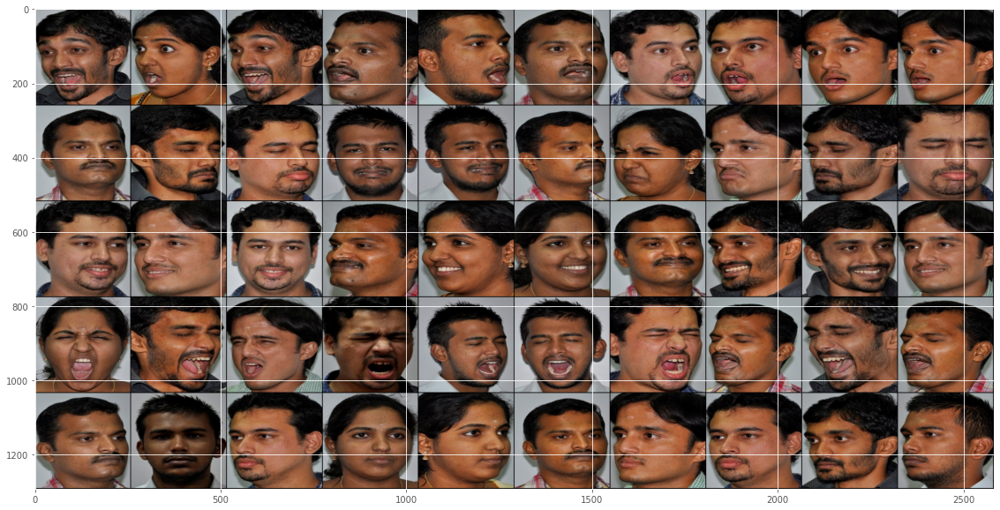

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


**Input from webcam as photo**

In [ ]:
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image

<IPython.core.display.Javascript object>

Saved to photo.jpg


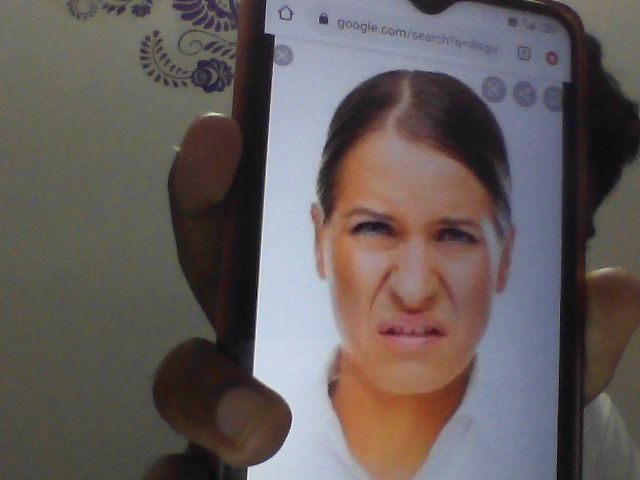

In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
# Read an image
image = cv2.imread('photo.jpg', cv2.IMREAD_COLOR)

# Recognize a facial expression if a face is detected. The boolean argument set to False indicates that the process runs on CPU
fer = cvision.recognize_facial_expression(image, False,False,True)

# Print list of emotions (individual classification from 9 convolutional branches and the ensemble classification)	
print('Individual classification from 9 convolutional branches: ',fer.list_emotion[:-1])
print('Ensemble classification: ',fer.list_emotion[-1])

Individual classification from 9 convolutional branches:  ['Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Sad']
Ensemble classification:  Disgust


# **Prototypical Network with 20 classes**


For this type we have implemented the Prototypical network in such a way that the images of 5 emotion classes namely - **Anger, Disgust, Happy, Neutral and Surprise** are data augmented via **rotation of 90,180 and 270 deg counter clockwise** thus giving rising the number of classes per emotion to 4 classes i.e for instance **Anger_0 (original image), Anger_90, Anger_180, Anger_270.**

This network is trained only on images from the emotions Anger, Disgust and Happy. Thus train set has images of the 12 classes. **The network is then tested on the 8 classes of the 2 emotions Neutral and Surprise and prediction is done using just 3 or 5 images which is few shot learning**

##Importing

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in each emotion folder
      if (int(img.split(".")[0])<41):#Take 40 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)

        #Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))
        
    # All images in e1 rotated at 90 will have the label e1_90
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions_Prototypical/train'

In [ ]:
%%time
trainx, trainy= read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 87.4 ms, sys: 148 ms, total: 235 ms
Wall time: 42.2 s


In [ ]:
trainx.shape, trainy.shape
#12 classes * 40 images per class = 480 images

((480, 256, 256, 3), (480,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

['e1_270', 'e2_270', 'e3_180', 'e1_90', 'e2_180']


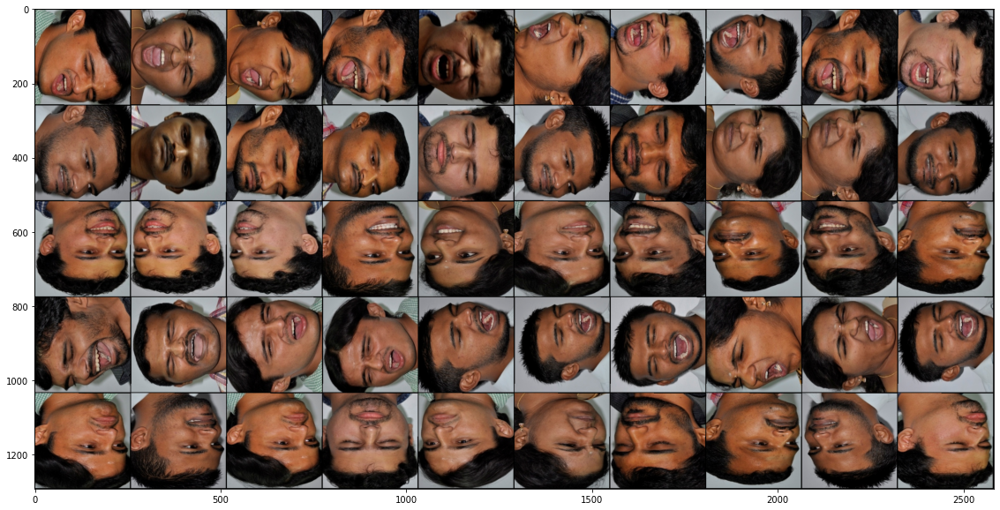

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. pass images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

Training is done on the 12 classes for 5 epochs and 2000 episodes with -

*   Number of random classes considered per episode = 5 

*   Number of support images = 5

*   Number of query images = 5




/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 4.7246 Acc: 0.8757



Epoch 2 -- Loss: 0.1114 Acc: 0.9591



Epoch 3 -- Loss: 0.0618 Acc: 0.9772



Epoch 4 -- Loss: 0.0378 Acc: 0.9868



Epoch 5 -- Loss: 0.0177 Acc: 0.9935
CPU times: user 20min 17s, sys: 13min 10s, total: 33min 27s
Wall time: 33min 29s


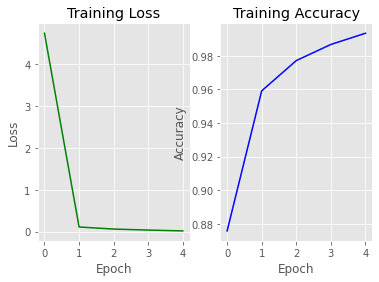

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #dimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 5
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 2000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest_final.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest_final.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

For testing we will be using images from the 2 emotions Neutral and Surprise respectively

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      if (int(img.split(".")[0])<41):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
            #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions_Prototypical/test'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 82.2 ms, sys: 116 ms, total: 198 ms
Wall time: 35.1 s


In [ ]:
testx.shape,testy.shape
# 8 classes and 40 images per class

((320, 256, 256, 3), (320,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

The below code runs for 2000 episodes that is every episode randomly takes 5 support images and 5 query images for all 8 classes, prediction is done on the query images and accuracy is found out. The final accuracy is the accuracy across 2000 episodes

In [ ]:
n_classes = 8
n_support = 5
n_query = 5

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 0.3363 Acc: 0.9107



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) 
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] 
    sample_cls1=np.concatenate((sample_cls, query))
    sample.append(sample_cls1)
  
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path,deg):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  image1 = ndimage.rotate(image1, deg)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e4_0":"Neutral_0","e4_90":"Neutral_90","e4_180":"Neutral_180","e4_270":"Neutral_270","e5_0":"Surprise_0","e5_90":"Surprise_90","e5_180":"Surprise_180","e5_270":"Surprise_270"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


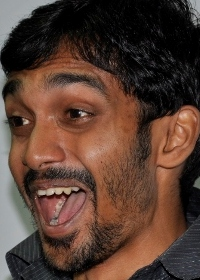

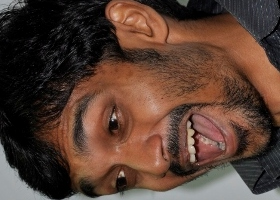

In [ ]:
from google.colab.patches import cv2_imshow
test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions_Prototypical/test/e5/37.jpg'
img = cv2.imread(test_image_path)
cv2_imshow(img)
img_rotate_90_counterclockwise = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
cv2_imshow(img_rotate_90_counterclockwise)

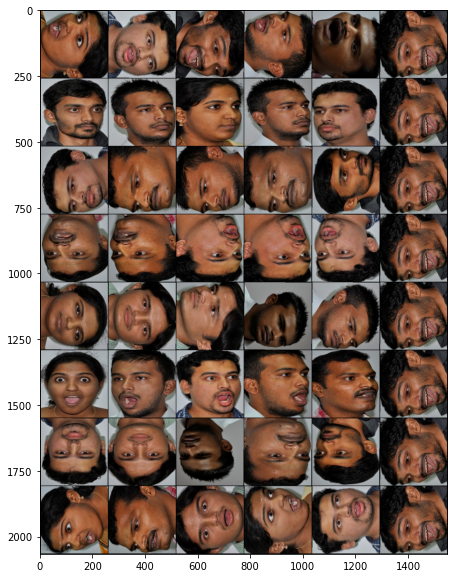

In [ ]:
query = read_test_image(test_image_path,90)
example1 = extract_image2(8, 5, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Surprise_90


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=["Neutral_0","Neutral_90","Neutral_180","Neutral_270","Surprise_0","Surprise_90","Surprise_180","Surprise_270"]
  PCLASSES= ACLASSES[::-1]
  list_deg=[0,90,180,270]
  list_acc=[[0 for i in range(8)] for j in range(8)]
  list_dict={"Neutral_0":1,"Neutral_90":2,"Neutral_180":3,"Neutral_270":4,"Surprise_0":5,"Surprise_90":6,"Surprise_180":7,"Surprise_270":8}
  for i in range(2):
    for j in range(1,41):
      for k in range(len(list_deg)):
        test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions_Prototypical/test/e'+str(i+4)+'/'+str(j)+'.jpg'
        test_query = read_test_image(test_image_path,list_deg[k])
        test_example1 = extract_image2(8, 5, test_query, testx, testy)
        prediction=predict_test(test_example1)
        pred=list_dict[prediction]
        list_acc[4*i+k][pred-1]+=1
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/40 for i in range(8)] for j in range(8)]
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


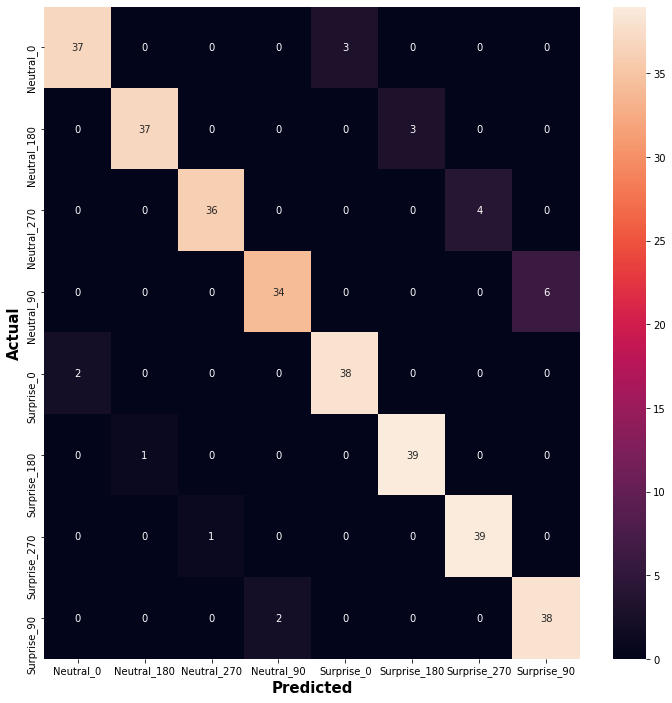

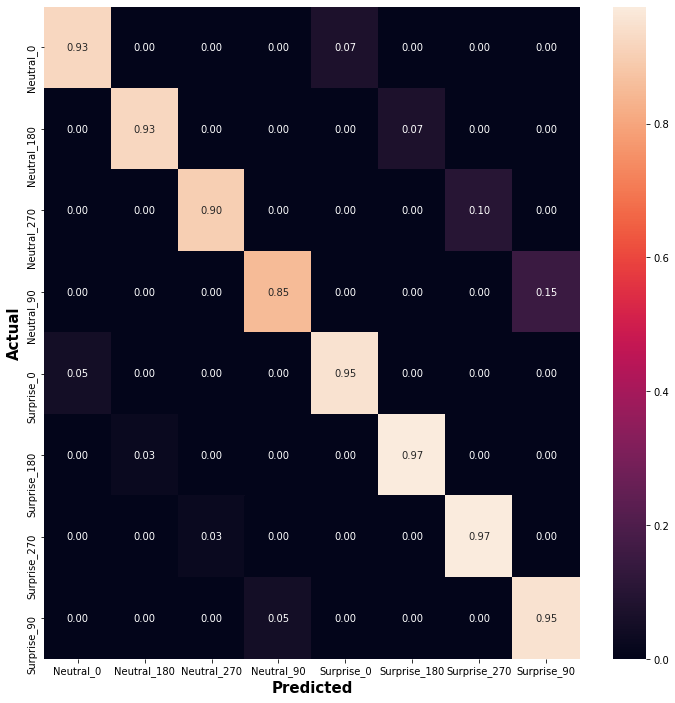

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


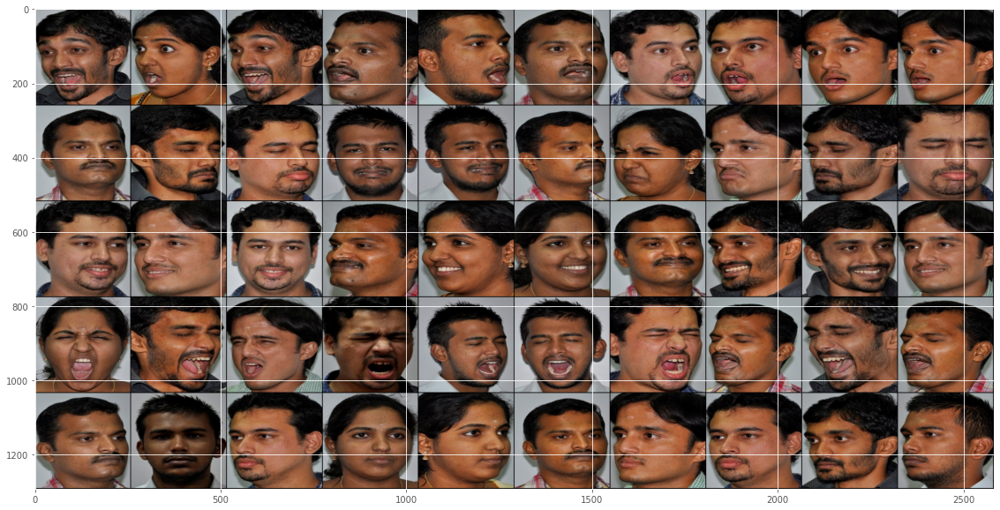

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


# **Prototypical Network with 20 classes**


For this type we have implemented the Prototypical network in such a way that the images of 5 emotion classes namely - **Anger, Disgust, Happy, Neutral and Surprise** are data augmented via **rotation of 90,180 and 270 deg counter clockwise** thus giving rising the number of classes per emotion to 4 classes i.e for instance **Anger_0 (original image), Anger_90, Anger_180, Anger_270.**

This network is trained only on images from the emotions Anger, Disgust and Happy. Thus train set has images of the 12 classes. **The network is then tested on the 8 classes of the 2 emotions Neutral and Surprise and prediction is done using just 3 or 5 images which is few shot learning**

##Importing

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in each emotion folder
      if (int(img.split(".")[0])<41):#Take 40 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)

        #Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))
        
    # All images in e1 rotated at 90 will have the label e1_90
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions_Prototypical/train'

In [ ]:
%%time
trainx, trainy= read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 102 ms, sys: 141 ms, total: 242 ms
Wall time: 47.6 s


In [ ]:
trainx.shape, trainy.shape
#12 classes * 40 images per class = 480 images

((480, 256, 256, 3), (480,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

['e3_90', 'e1_0', 'e3_180', 'e1_90', 'e2_0']


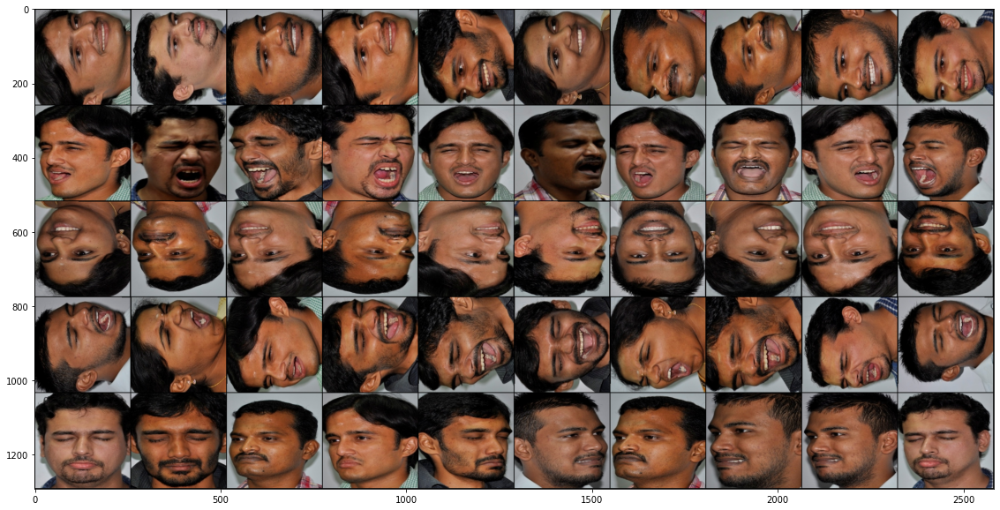

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. you pass your images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of your vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

Training is done on the 12 classes for 5 epochs and 2000 episodes with -

*   Number of random classes considered per episode = 5 

*   Number of support images = 5

*   Number of query images = 5




/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 3.6400 Acc: 0.8580



Epoch 2 -- Loss: 0.2062 Acc: 0.9386



Epoch 3 -- Loss: 0.0737 Acc: 0.9716



Epoch 4 -- Loss: 0.0370 Acc: 0.9866



Epoch 5 -- Loss: 0.0157 Acc: 0.9943
CPU times: user 20min 18s, sys: 13min 31s, total: 33min 50s
Wall time: 33min 54s


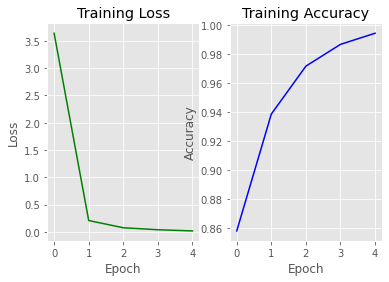

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #dimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 5
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 2000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest2.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

For testing we will be using images from the 2 emotions Neutral and Surprise respectively

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      if (int(img.split(".")[0])<41):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
            #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions_Prototypical/test'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 63.3 ms, sys: 112 ms, total: 176 ms
Wall time: 29.1 s


In [ ]:
testx.shape,testy.shape
# 8 classes and 40 images per class

((320, 256, 256, 3), (320,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

The below code runs for 2000 episodes that is every episode randomly takes 5 support images and 5 query images for all 8 classes, prediction is done on the query images and accuracy is found out. The final accuracy is the accuracy across 2000 episodes

In [ ]:
n_classes = 8
n_support = 5
n_query = 5

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 0.4411 Acc: 0.8719



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) 
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] 
    sample_cls1=np.concatenate((sample_cls, query))
    sample.append(sample_cls1)
  
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path,deg):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  image1 = ndimage.rotate(image1, deg)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e4_0":"Neutral_0","e4_90":"Neutral_90","e4_180":"Neutral_180","e4_270":"Neutral_270","e5_0":"Surprise_0","e5_90":"Surprise_90","e5_180":"Surprise_180","e5_270":"Surprise_270"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


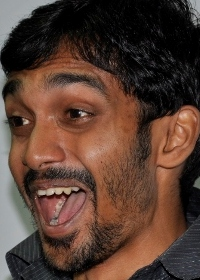

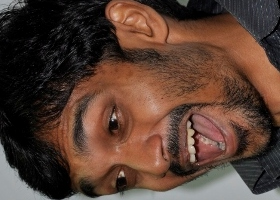

In [ ]:
#import cv2
from google.colab.patches import cv2_imshow
test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions_Prototypical/test/e5/37.jpg'
img = cv2.imread(test_image_path)
cv2_imshow(img)
img_rotate_90_counterclockwise = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
cv2_imshow(img_rotate_90_counterclockwise)

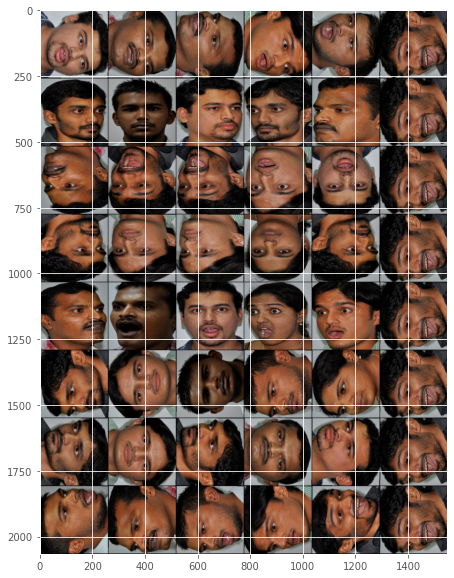

In [ ]:
query = read_test_image(test_image_path,90)
example1 = extract_image2(8, 5, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Surprise_90


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=["Neutral_0","Neutral_90","Neutral_180","Neutral_270","Surprise_0","Surprise_90","Surprise_180","Surprise_270"]
  PCLASSES= ACLASSES[::-1]
  list_deg=[0,90,180,270]
  list_acc=[[0 for i in range(8)] for j in range(8)]
  list_dict={"Neutral_0":1,"Neutral_90":2,"Neutral_180":3,"Neutral_270":4,"Surprise_0":5,"Surprise_90":6,"Surprise_180":7,"Surprise_270":8}
  for i in range(2):
    for j in range(31,41):
      for k in range(len(list_deg)):
        test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions_Prototypical/test/e'+str(i+4)+'/'+str(j)+'.jpg'
        test_query = read_test_image(test_image_path,list_deg[k])
        test_example1 = extract_image2(8, 5, test_query, testx, testy)
        prediction=predict_test(test_example1)
        pred=list_dict[prediction]
        list_acc[4*i+k][pred-1]+=1
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/10 for i in range(8)] for j in range(8)]
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


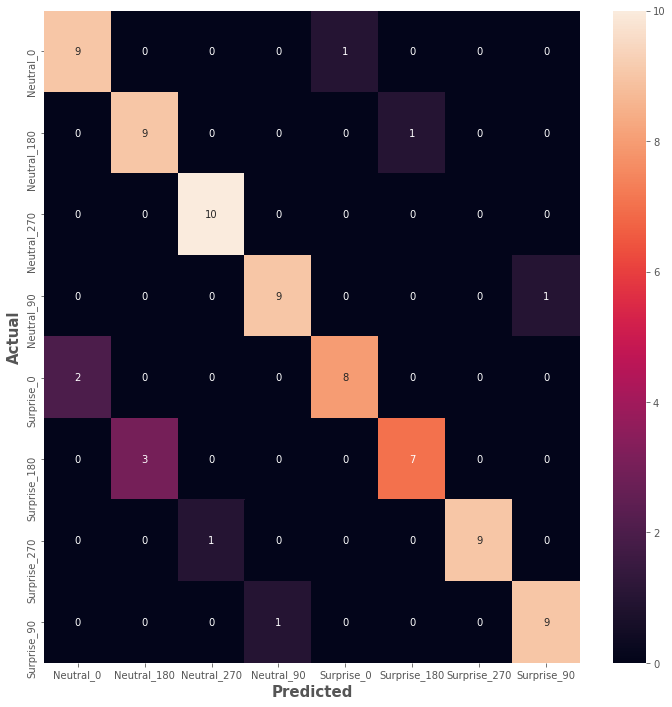

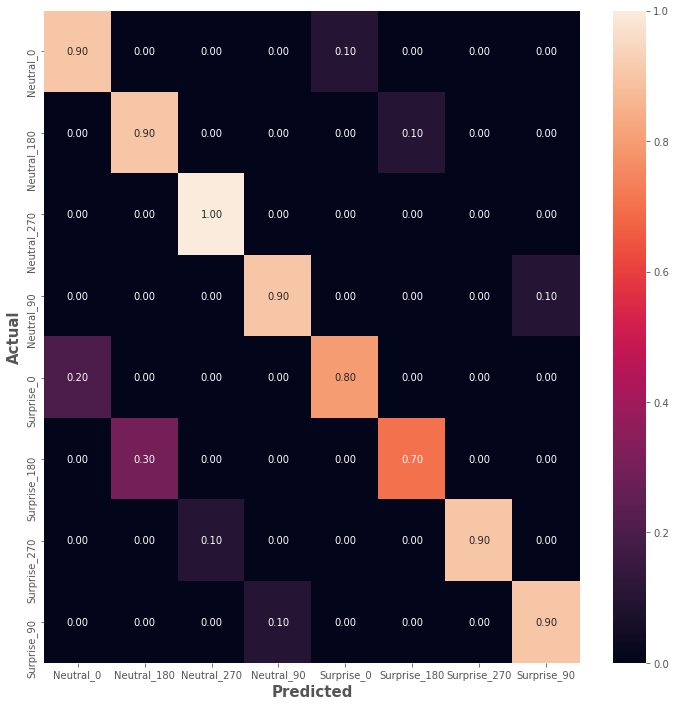

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


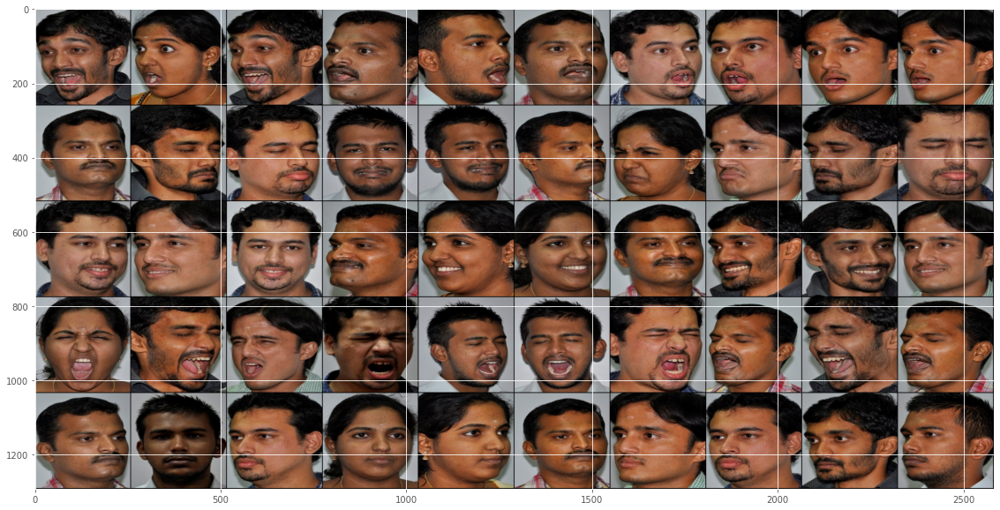

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


**Input from webcam as photo**

In [ ]:
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image

<IPython.core.display.Javascript object>

Saved to photo.jpg


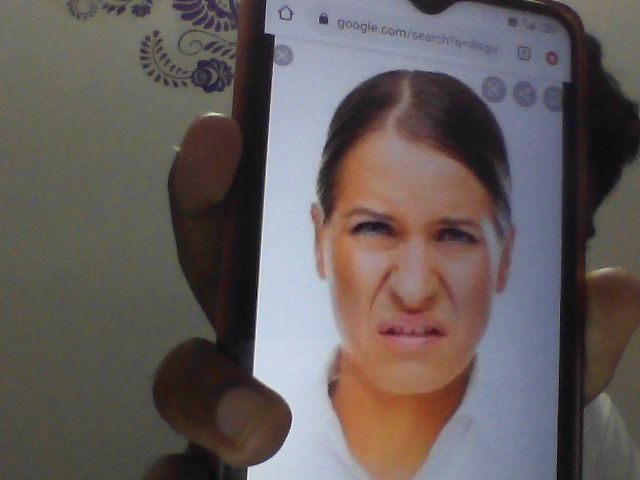

In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
# Read an image
image = cv2.imread('photo.jpg', cv2.IMREAD_COLOR)

# Recognize a facial expression if a face is detected. The boolean argument set to False indicates that the process runs on CPU
fer = cvision.recognize_facial_expression(image, False,False,True)

# Print list of emotions (individual classification from 9 convolutional branches and the ensemble classification)	
print('Individual classification from 9 convolutional branches: ',fer.list_emotion[:-1])
print('Ensemble classification: ',fer.list_emotion[-1])

Individual classification from 9 convolutional branches:  ['Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Sad']
Ensemble classification:  Disgust


# **Prototypical Network with 20 classes using CMU for testing**


For this type we have implemented the Prototypical network in such a way that the images of 5 emotion classes namely - **Anger, Disgust, Happy, Neutral and Surprise** are data augmented via **rotation of 90,180 and 270 deg counter clockwise** thus giving rising the number of classes per emotion to 4 classes i.e for instance **Anger_0 (original image), Anger_90, Anger_180, Anger_270.**

This network is trained only on images from the emotions Anger, Disgust and Happy. Thus train set has images of the 12 classes. **The network is then tested on the 8 classes of the 2 emotions Neutral and Surprise and prediction is done using just 3 or 5 images which is few shot learning**

##Importing

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in each emotion folder
      if (int(img.split(".")[0])<41):#Take 40 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)

        #Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))
        
    # All images in e1 rotated at 90 will have the label e1_90
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions_Prototypical/train'

In [ ]:
%%time
trainx, trainy= read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 87.4 ms, sys: 148 ms, total: 235 ms
Wall time: 42.2 s


In [ ]:
trainx.shape, trainy.shape
#12 classes * 40 images per class = 480 images

((480, 256, 256, 3), (480,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

['e1_270', 'e2_270', 'e3_180', 'e1_90', 'e2_180']


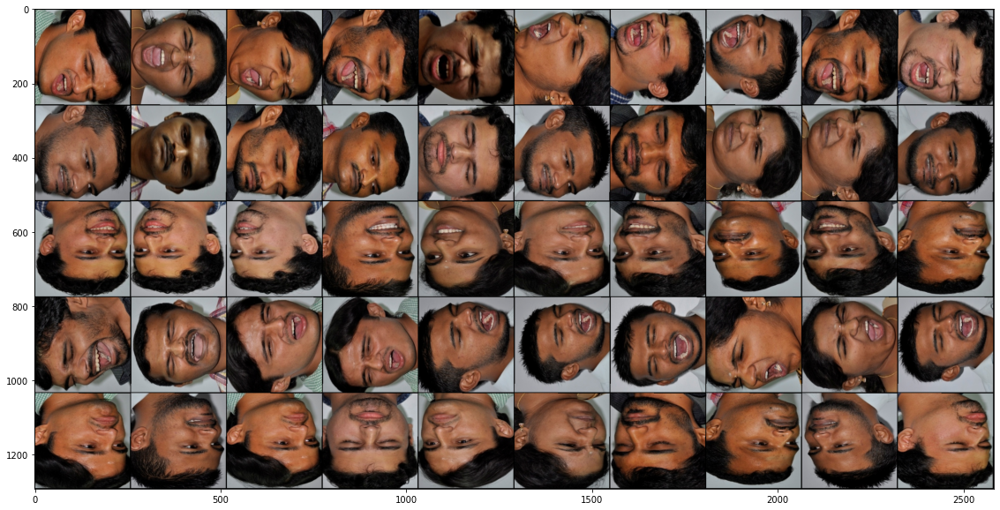

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. pass images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

Training is done on the 12 classes for 5 epochs and 2000 episodes with -

*   Number of random classes considered per episode = 5 

*   Number of support images = 5

*   Number of query images = 5




/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 4.7246 Acc: 0.8757



Epoch 2 -- Loss: 0.1114 Acc: 0.9591



Epoch 3 -- Loss: 0.0618 Acc: 0.9772



Epoch 4 -- Loss: 0.0378 Acc: 0.9868



Epoch 5 -- Loss: 0.0177 Acc: 0.9935
CPU times: user 20min 17s, sys: 13min 10s, total: 33min 27s
Wall time: 33min 29s


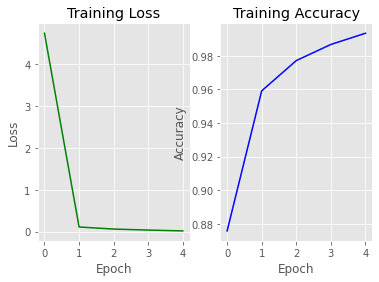

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #dimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 5
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 2000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest_final.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest_final.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

For testing we will be using images from the 2 emotions Neutral and Surprise respectively

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      #if (int(img.split(".")[0])<41):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
            #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/CMU_Prototypical_Surprise_Neutral'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 111 ms, sys: 214 ms, total: 325 ms
Wall time: 1min 3s


In [ ]:
testx.shape,testy.shape
# 8 classes and 40 images per class

((560, 256, 256, 3), (560,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

The below code runs for 2000 episodes that is every episode randomly takes 5 support images and 5 query images for all 8 classes, prediction is done on the query images and accuracy is found out. The final accuracy is the accuracy across 2000 episodes

In [ ]:
n_classes = 8
n_support = 10
n_query = 10

test_x = testx
test_y = testy

test_episode = 1000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 4.2615 Acc: 0.3988



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) 
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] 
    sample_cls1=np.concatenate((sample_cls, query))
    sample.append(sample_cls1)
  
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path,deg):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  image1 = ndimage.rotate(image1, deg)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e4_0":"Neutral_0","e4_90":"Neutral_90","e4_180":"Neutral_180","e4_270":"Neutral_270","e5_0":"Surprise_0","e5_90":"Surprise_90","e5_180":"Surprise_180","e5_270":"Surprise_270"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


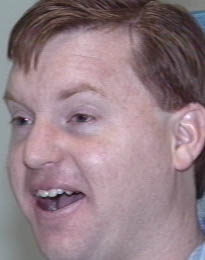

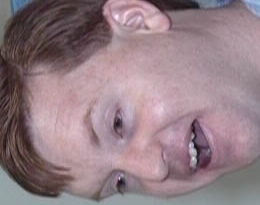

In [ ]:
from google.colab.patches import cv2_imshow
test_image_path = '/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/e5/006_02_02_130_05.jpg'
img = cv2.imread(test_image_path)
cv2_imshow(img)
img_rotate_90_counterclockwise = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
cv2_imshow(img_rotate_90_counterclockwise)

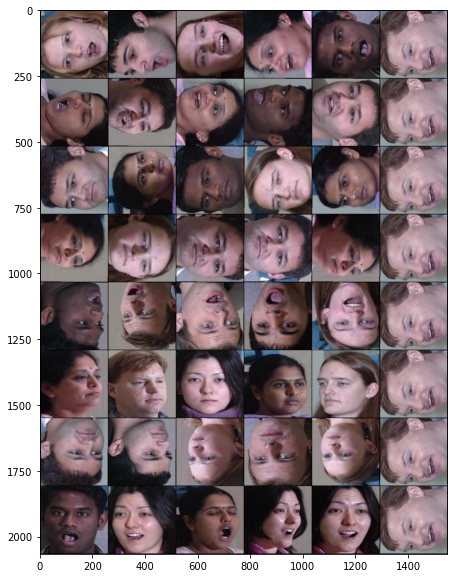

In [ ]:
query = read_test_image(test_image_path,90)
example1 = extract_image2(8, 5, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Surprise_90


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=["Neutral_0","Neutral_90","Neutral_180","Neutral_270","Surprise_0","Surprise_90","Surprise_180","Surprise_270"]
  PCLASSES= ACLASSES[::-1]
  list_deg=[0,90,180,270]
  list_acc=[[0 for i in range(8)] for j in range(8)]
  list_dict={"Neutral_0":1,"Neutral_90":2,"Neutral_180":3,"Neutral_270":4,"Surprise_0":5,"Surprise_90":6,"Surprise_180":7,"Surprise_270":8}
  
  for i in range(2):
    emotion_directory_path='/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/e'+str(i+4)
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:
      for k in range(len(list_deg)):
        #test_image_path = '/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/e'+str(i+4)+'/'+str(j)+'.jpg'
        #print(img)
        image = emotion_directory_path+'/'+img
        #print(image)
        test_query = read_test_image(image,list_deg[k])
        test_example1 = extract_image2(8, 5, test_query, testx, testy)
        prediction=predict_test(test_example1)
        pred=list_dict[prediction]
        list_acc[4*i+k][pred-1]+=1
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/70 for i in range(8)] for j in range(8)]
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


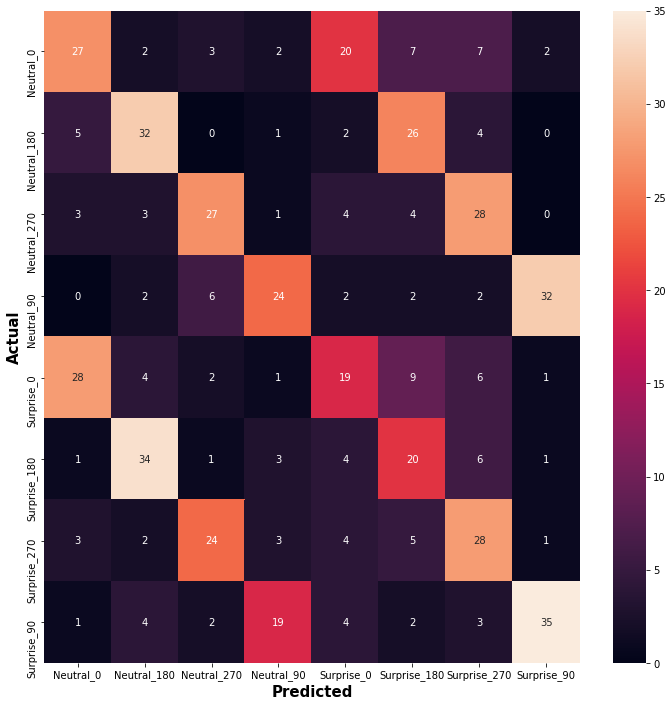

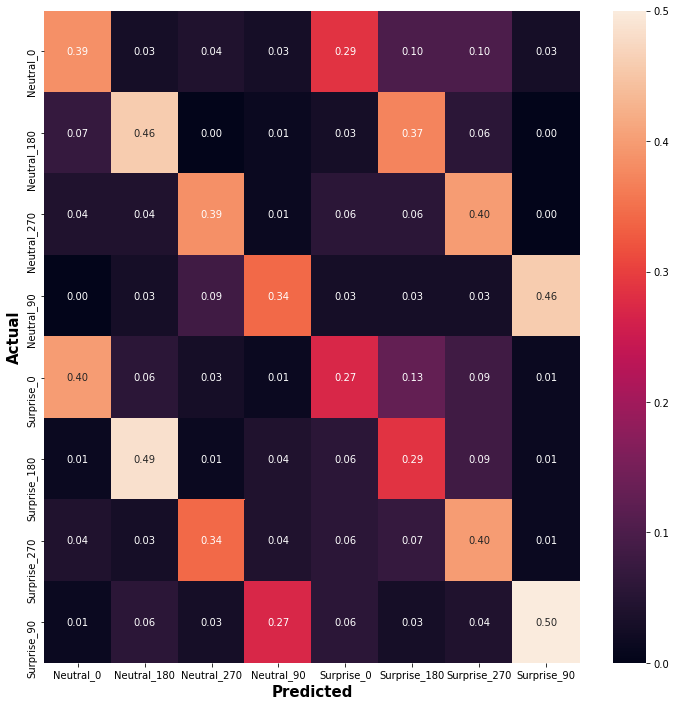

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


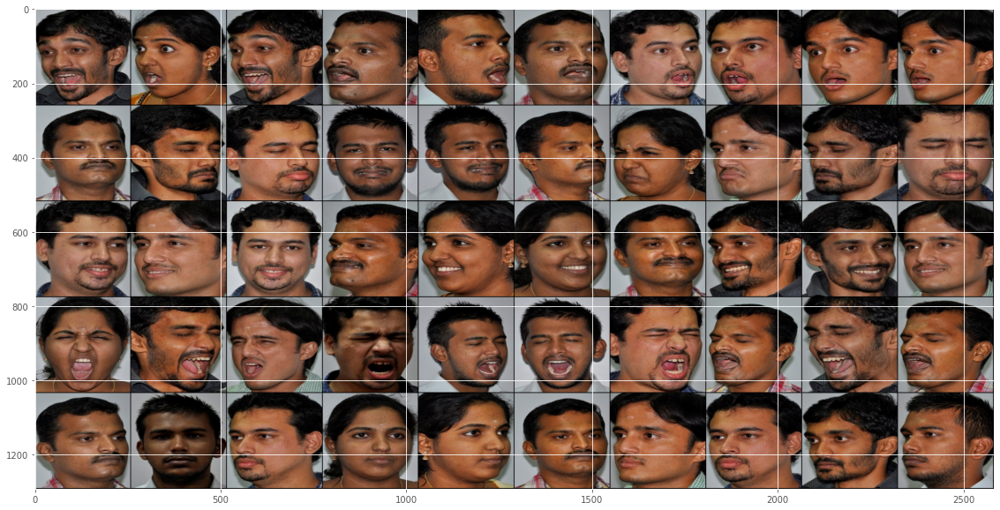

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


# **Prototypical Network with 20 classes using CMU for training and testing**


For this type we have implemented the Prototypical network in such a way that the images of 5 emotion classes namely - **Anger, Disgust, Happy, Neutral and Surprise** are data augmented via **rotation of 90,180 and 270 deg counter clockwise** thus giving rising the number of classes per emotion to 4 classes i.e for instance **Anger_0 (original image), Anger_90, Anger_180, Anger_270.**

This network is trained only on images from the emotions Anger, Disgust and Happy. Thus train set has images of the 12 classes. **The network is then tested on the 8 classes of the 2 emotions Neutral and Surprise and prediction is done using just 3 or 5 images which is few shot learning**

##Importing

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in each emotion folder
      #if (int(img.split(".")[0])<41):#Take 40 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)

        #Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))
        
    # All images in e1 rotated at 90 will have the label e1_90
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/train'

In [ ]:
%%time
trainx, trainy= read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 314 ms, sys: 264 ms, total: 578 ms
Wall time: 51.9 s


In [ ]:
trainx.shape, trainy.shape
#12 classes * 40 images per class = 480 images

((840, 256, 256, 3), (840,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


['e1_90', 'e3_270', 'e1_0', 'e3_90', 'e2_90']


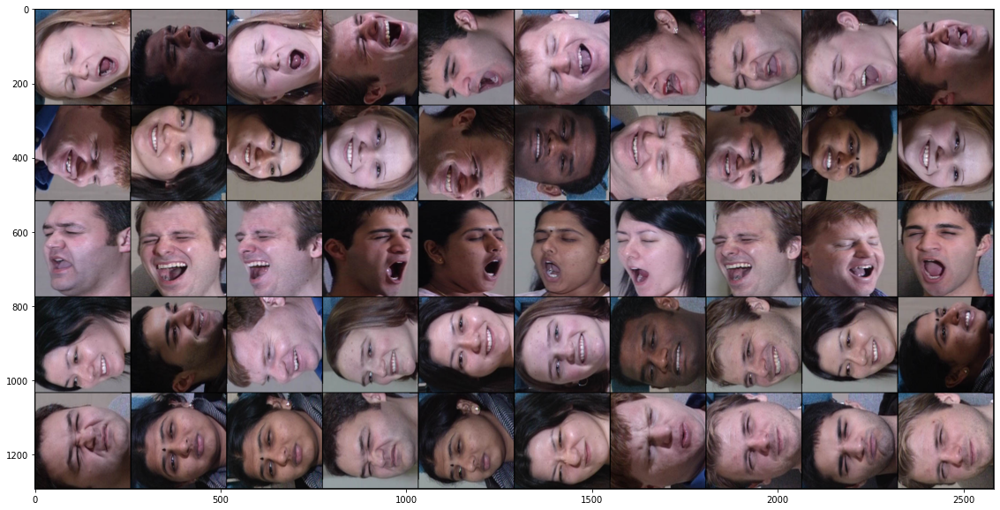

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. pass images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

Training is done on the 12 classes for 5 epochs and 2000 episodes with -

*   Number of random classes considered per episode = 5 

*   Number of support images = 5

*   Number of query images = 5




/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 7.3527 Acc: 0.5392



Epoch 2 -- Loss: 0.5596 Acc: 0.7647



Epoch 3 -- Loss: 0.2676 Acc: 0.8975



Epoch 4 -- Loss: 0.1312 Acc: 0.9520



Epoch 5 -- Loss: 0.0592 Acc: 0.9787
CPU times: user 40min 13s, sys: 23min 17s, total: 1h 3min 30s
Wall time: 1h 3min 20s


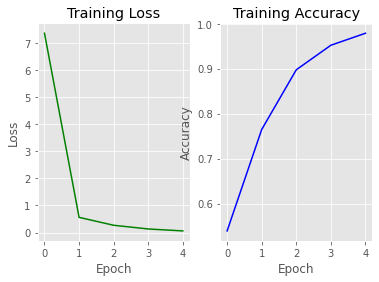

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #dimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 12
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 2000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest_cmu1.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq_traintest_cmu1.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

For testing we will be using images from the 2 emotions Neutral and Surprise respectively

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      #if (int(img.split(".")[0])<41):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
            #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/test'

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions_Prototypical/test'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 111 ms, sys: 130 ms, total: 241 ms
Wall time: 20.9 s


In [ ]:
testx.shape,testy.shape
# 8 classes and 40 images per class

((320, 256, 256, 3), (320,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

The below code runs for 2000 episodes that is every episode randomly takes 5 support images and 5 query images for all 8 classes, prediction is done on the query images and accuracy is found out. The final accuracy is the accuracy across 2000 episodes

In [ ]:
n_classes = 8
n_support = 5
n_query = 5

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 0.4215 Acc: 0.8743


In [ ]:
n_classes = 8
n_support = 5
n_query = 5

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 13.4649 Acc: 0.5226



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) 
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] 
    sample_cls1=np.concatenate((sample_cls, query))
    sample.append(sample_cls1)
  
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path,deg):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  image1 = ndimage.rotate(image1, deg)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e4_0":"Neutral_0","e4_90":"Neutral_90","e4_180":"Neutral_180","e4_270":"Neutral_270","e5_0":"Surprise_0","e5_90":"Surprise_90","e5_180":"Surprise_180","e5_270":"Surprise_270"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


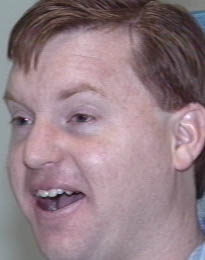

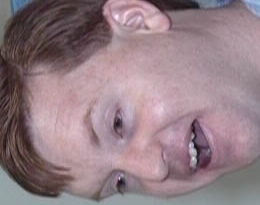

In [ ]:
from google.colab.patches import cv2_imshow
test_image_path = '/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/test/e5/006_02_02_130_05.jpg'
img = cv2.imread(test_image_path)
cv2_imshow(img)
img_rotate_90_counterclockwise = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
cv2_imshow(img_rotate_90_counterclockwise)

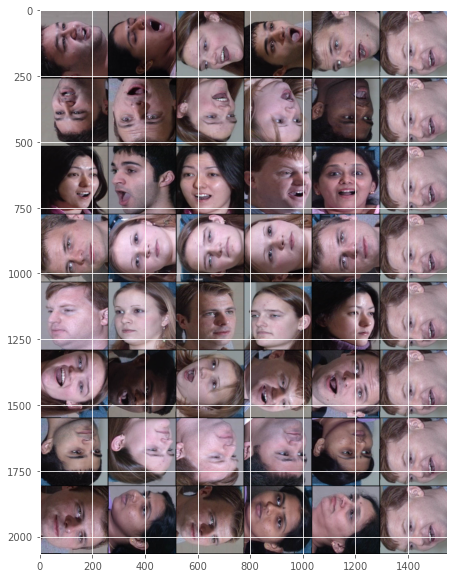

In [ ]:
query = read_test_image(test_image_path,90)
example1 = extract_image2(8, 5, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Surprise_90


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=["Neutral_0","Neutral_90","Neutral_180","Neutral_270","Surprise_0","Surprise_90","Surprise_180","Surprise_270"]
  PCLASSES= ACLASSES[::-1]
  list_deg=[0,90,180,270]
  list_acc=[[0 for i in range(8)] for j in range(8)]
  list_dict={"Neutral_0":1,"Neutral_90":2,"Neutral_180":3,"Neutral_270":4,"Surprise_0":5,"Surprise_90":6,"Surprise_180":7,"Surprise_270":8}
  
  for i in range(2):
    emotion_directory_path='/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/test/e'+str(i+4)
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:
      for k in range(len(list_deg)):
        #test_image_path = '/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/e'+str(i+4)+'/'+str(j)+'.jpg'
        #print(img)
        image = emotion_directory_path+'/'+img
        #print(image)
        test_query = read_test_image(image,list_deg[k])
        test_example1 = extract_image2(8, 5, test_query, testx, testy)
        prediction=predict_test(test_example1)
        pred=list_dict[prediction]
        list_acc[4*i+k][pred-1]+=1
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/70 for i in range(8)] for j in range(8)]
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


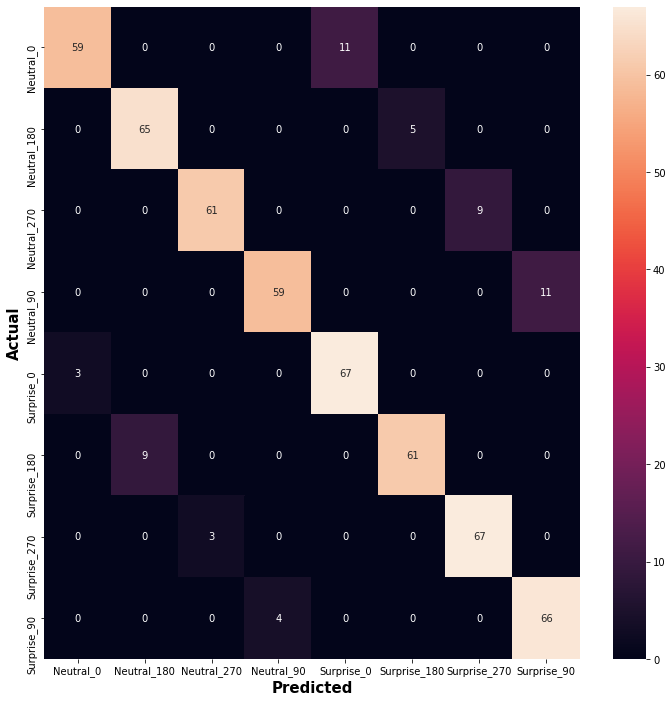

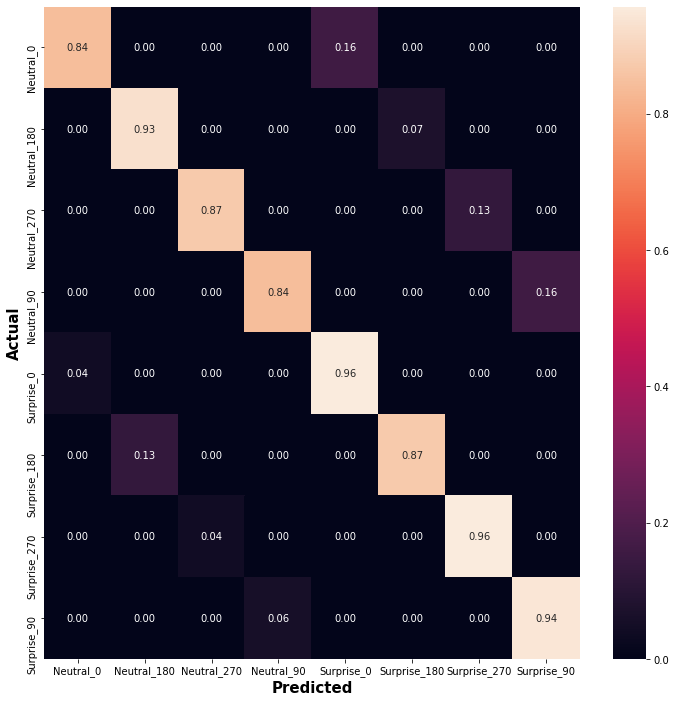

In [ ]:
confusion_matrix(testx,testy)

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=["Neutral_0","Neutral_90","Neutral_180","Neutral_270","Surprise_0","Surprise_90","Surprise_180","Surprise_270"]
  PCLASSES= ACLASSES[::-1]
  list_deg=[0,90,180,270]
  list_acc=[[0 for i in range(8)] for j in range(8)]
  list_dict={"Neutral_0":1,"Neutral_90":2,"Neutral_180":3,"Neutral_270":4,"Surprise_0":5,"Surprise_90":6,"Surprise_180":7,"Surprise_270":8}
  
  for i in range(2):
    #emotion_directory_path='/content/drive/MyDrive/ProjectPhase/CMU_Prototypical_Surprise_Neutral/test/e'+str(i+4)
    #images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for j in range(1,41):
      for k in range(len(list_deg)):
        test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions_Prototypical/test/e'+str(i+4)+'/'+str(j)+'.jpg'
        #print(img)
        #image = emotion_directory_path+'/'+img
        #print(test_image_path)
        test_query = read_test_image(test_image_path,list_deg[k])
        test_example1 = extract_image2(8, 5, test_query, testx, testy)
        prediction=predict_test(test_example1)
        pred=list_dict[prediction]
        list_acc[4*i+k][pred-1]+=1
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/40 for i in range(8)] for j in range(8)]
  f,ax=plt.subplots(figsize=(12,12))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


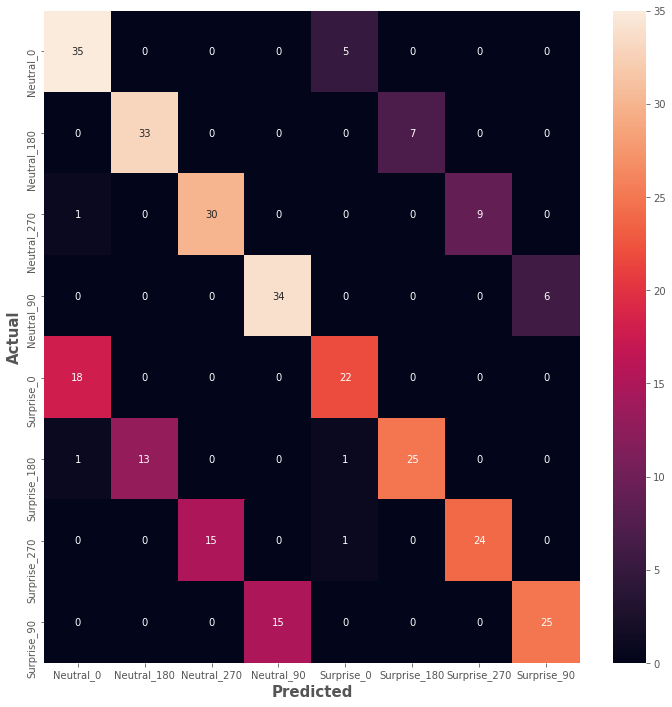

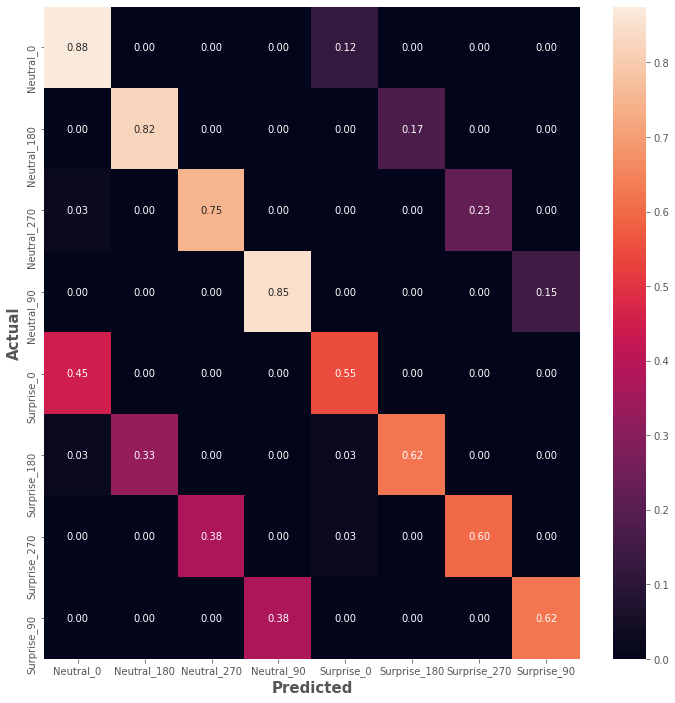

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


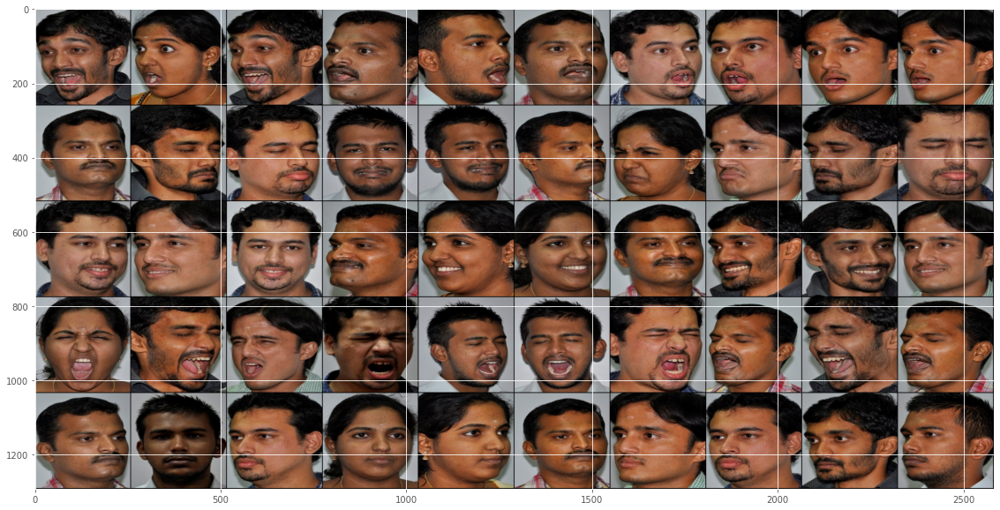

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


# **Prototypical Network with 5 classes using CMU for testing**


##Importing

Pytorch, Numpy

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in e1
      if (int(img.split(".")[0])<31):#Take only 30 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
        data.append(image)
        labels.append(emotion_directory_name)

        """#Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))"""
        
    # All images in e1 rotated at 90 will have the label e1_90
    # Hence every emotion(e1,e2,e3,e4,e5) will have 4 different classes
    # 5 emotions * 4 classes per emotion = 20 classes
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            #array([[...],[...],[...]])
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions'

In [ ]:
%%time
trainx, trainy = read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 38.3 ms, sys: 71.1 ms, total: 109 ms
Wall time: 45.4 s


In [ ]:
trainx.shape, trainy.shape
#20 classes * 30 images per class = 600 images

((150, 256, 256, 3), (150,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

['e5', 'e3', 'e2', 'e4', 'e1']


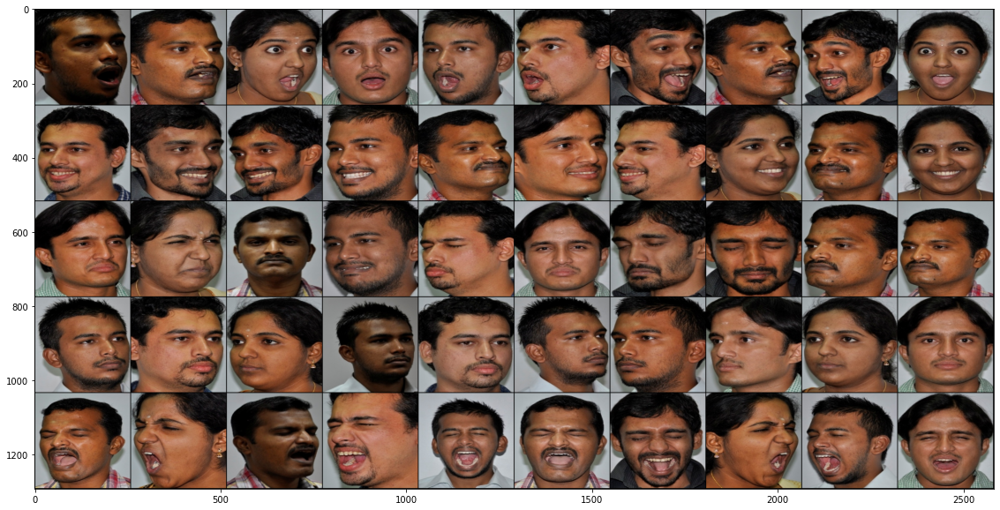

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. you pass your images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of your vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 4.3259 Acc: 0.8064



Epoch 2 -- Loss: 0.0369 Acc: 0.9889



Epoch 3 -- Loss: 0.0003 Acc: 0.9999
CPU times: user 12min 6s, sys: 7min 34s, total: 19min 40s
Wall time: 19min 44s


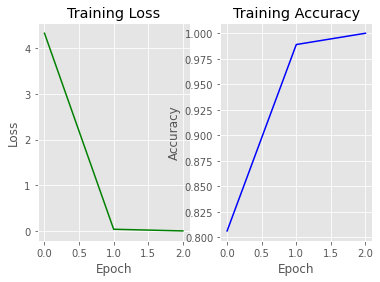

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #ddimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 5
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 1000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_5class_5ns_5nq.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_5class_3ns_3nq.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      if (int(img.split(".")[0])>30):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
        data.append(image)
        labels.append(emotion_directory_name)
        """    #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))"""
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/Emotions'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 18.7 ms, sys: 84.5 ms, total: 103 ms
Wall time: 19.9 s


In [ ]:
testx.shape,testy.shape

((55, 256, 256, 3), (55,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

In [ ]:
n_classes = 5
n_support = 7
n_query = 3

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 1.1994 Acc: 0.7328



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    #print(sample_cls.shape)
    sample_cls1=np.concatenate((sample_cls, query))
    #print(sample_cls1.shape)
    sample.append(sample_cls1)
    #print(sample.shape)
    # sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e1":"Anger","e2":"Disgust","e3":"Happy","e4":"Neutral","e5":"Surprise"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


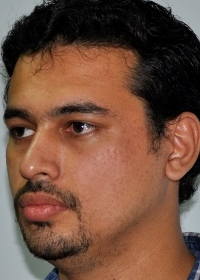

In [ ]:
#from IPython.display import Image
test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e4/38.jpg'
display(Image(test_image_path))

In [ ]:
test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e4/38.jpg'
Image.open(test_image_path)

AttributeError: ignored

torch.Size([5, 4, 3, 256, 256])


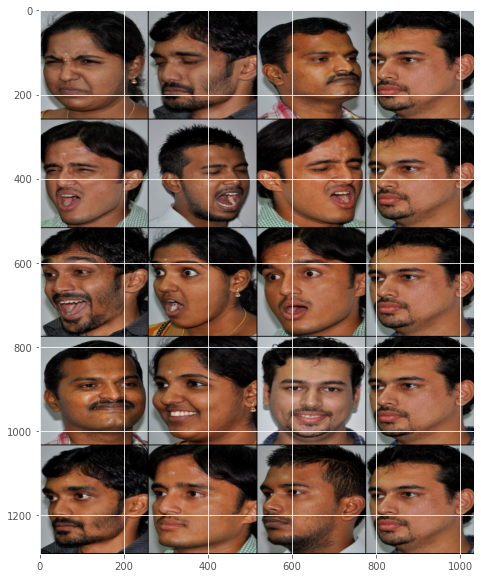

In [ ]:
query = read_test_image(test_image_path)
example1 = extract_image2(5, 3, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Neutral


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=['Anger', 'Disgust', 'Happy', 'Neutral', 'Surprise']
  PCLASSES=['Surprise', 'Neutral', 'Happy', 'Disgust', 'Anger']
  list_acc=[[0 for i in range(5)] for j in range(5)]
  list_dict={"Anger":1,"Disgust":2,"Happy":3,"Neutral":4,"Surprise":5}
  for i in range(5):
    for j in range(31,41):
      test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e'+str(i+1)+'/'+str(j)+'.jpg'
      test_query = read_test_image(test_image_path)
      test_example1 = extract_image2(5, 5, test_query, testx, testy)
      prediction=predict_test(test_example1)
      pred=list_dict[prediction]
      list_acc[i][pred-1]+=1
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/10 for i in range(5)] for j in range(5)]
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


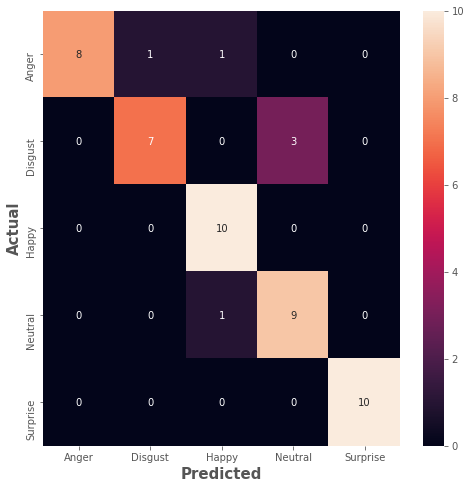

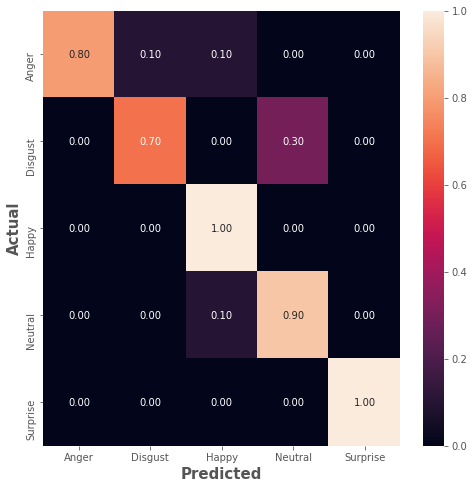

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


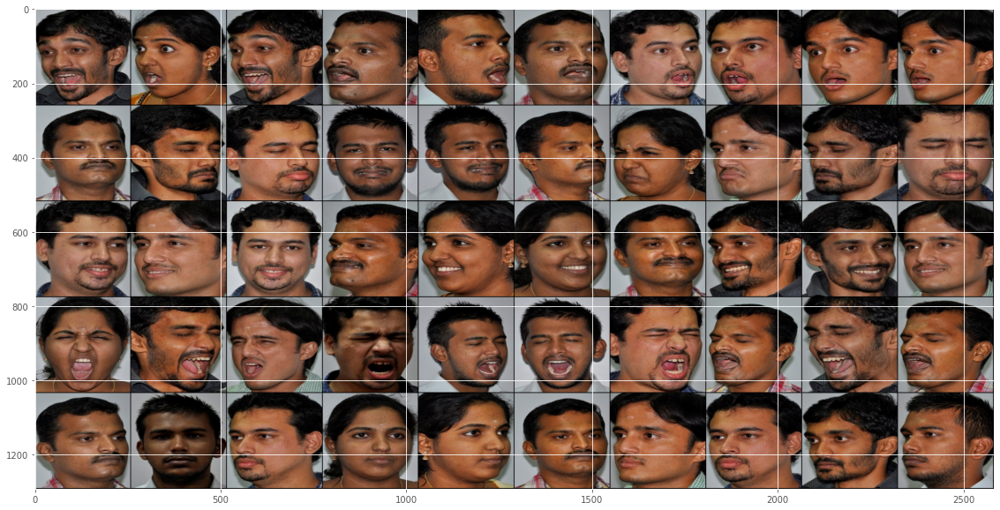

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


**Input from webcam as photo**

In [ ]:
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image

<IPython.core.display.Javascript object>

Saved to photo.jpg


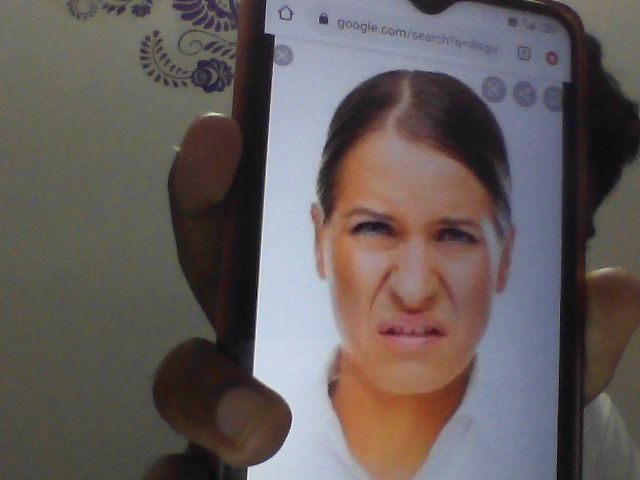

In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
# Read an image
image = cv2.imread('photo.jpg', cv2.IMREAD_COLOR)

# Recognize a facial expression if a face is detected. The boolean argument set to False indicates that the process runs on CPU
fer = cvision.recognize_facial_expression(image, False,False,True)

# Print list of emotions (individual classification from 9 convolutional branches and the ensemble classification)	
print('Individual classification from 9 convolutional branches: ',fer.list_emotion[:-1])
print('Ensemble classification: ',fer.list_emotion[-1])

Individual classification from 9 convolutional branches:  ['Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Sad']
Ensemble classification:  Disgust


# **Prototypical Network with 5 classes using CMU for training and testing**


##Importing

Pytorch, Numpy

In [ ]:
import numpy as np
import os
from PIL import Image
from sklearn.model_selection import train_test_split
from keras import backend as K
from keras.layers import Activation
from keras.layers import Input, Lambda, Dense, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
from imutils import paths
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage
import multiprocessing as mp
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Reading train data

In [ ]:
def read_emotions(emotion_directory_path, emotion_directory_name):
    """
    Reads all the images from a given emotion_directory
    """
    data = [] #Storing images
    labels = [] #Storing labels
    images_dir = os.listdir(emotion_directory_path) #/content/drive/My Drive/DatasetPP2/e1/
    for img in images_dir:# Images stored in e1
      #if (int(img.split(".")[0])<31):#Take only 30 images for training
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
        data.append(image)
        labels.append(emotion_directory_name)

        """#Data Augmentation
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        #Rotate the image with angles 90,180 and 270

        data.extend((image, rotated_90, rotated_180, rotated_270)) #The original and rotated images are added to the data list
        labels.extend((
                emotion_directory_name + '_0', #e1_0
                emotion_directory_name + '_90',#e1_90
                emotion_directory_name + '_180',#e1_180
                emotion_directory_name + '_270'#e1_270
            ))"""
        
    # All images in e1 rotated at 90 will have the label e1_90
    # Hence every emotion(e1,e2,e3,e4,e5) will have 4 different classes
    # 5 emotions * 4 classes per emotion = 20 classes
    return np.array(data), np.array(labels)

In [ ]:
def read_images(base_directory):
    """
    Reads all the emotions from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    images = None
    labels = None
    pool = mp.Pool(mp.cpu_count())# Multiprocessing 
    #cpu_count() gives maximum number of processes we can run at any given moment 
    #Pool class distributes the tasks to the worker processes and collects the return values in the form of a list(FIFO)
    results = [pool.apply(read_emotions,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)] #directory = e1,e2,e3,e4,e5
    #pool.apply maintains an ordered list of results
    pool.close() #We cannot submit new tasks to our pool of worker processes
    for result in results: #results contain [data,labels] for every emotion
        if images is None:
            images = result[0]#stores the data of the first emotion
            labels = result[1]#stores the labels of the first emotion
        else:
            images = np.vstack([images, result[0]])#Stacks arrays in sequence vertically(row wise)
            #array([[...],[...],[...]])
            labels = np.concatenate([labels, result[1]])
    return images, labels

In [ ]:
dir = '/content/drive/My Drive/ProjectPhase/CMU_Prototypical/train'

In [ ]:
%%time
trainx, trainy = read_images(dir)
#trainx contains all images required for training
#trainy contains the corresponding labels

CPU times: user 304 ms, sys: 144 ms, total: 448 ms
Wall time: 1min 45s


In [ ]:
trainx.shape, trainy.shape
#20 classes * 30 images per class = 600 images

((200, 256, 256, 3), (200,))

## Extracting sample images

In [ ]:
def extract_image(n_classes, n_support, n_query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support+n_query)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    sample.append(sample_cls)# sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': n_query,
      'final_label':final_label
      })

In [ ]:
def display1(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (20,10))
  plt.imshow(out.permute(1, 2, 0))

/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


['e4', 'e3', 'e2', 'e5', 'e1']


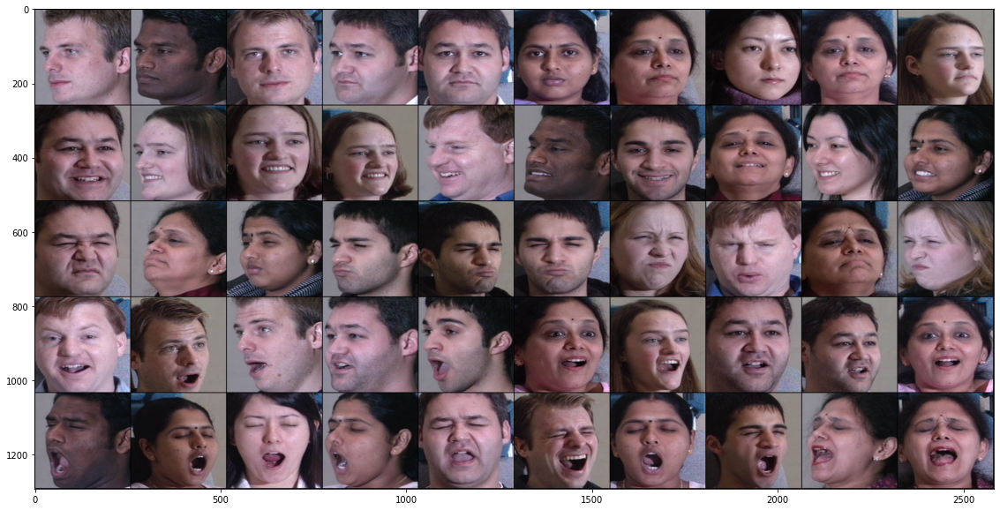

In [ ]:
example = extract_image(5, 5, 5, trainx, trainy)
display1(example['images'])
print(example['final_label'])

In [ ]:
example['images'].shape

torch.Size([5, 10, 3, 256, 256])

## Building Prototypical network

Unlike typical deep learning architecture, prototypical networks do not classify the image directly, and instead learn the mapping of an image in metric space.
An encoder maps an image into a vector in the embedding space. Support images are used to define the prototype. Distances between prototypes and encoded query images are used to classify them.
The main advantage of working in that embedding space is that two images that look the same will be close to each other, and two images that are completely different will be far away

In [ ]:
class Flatten(nn.Module):
  def __init__(self):
    super(Flatten, self).__init__()

  def forward(self, x):
    return x.view(x.size(0), -1)

In [ ]:
#Basically. you pass your images through a CNN (the encoder) with decreasing layer size. 
#The last layer of this network is the one that produce the embeddings (that is, a lower dimensional representation of your input)
#The number of neurons you use here is the length of your vector embedding for the input images
def load_protonet_conv(**kwargs):
  """
  Loads the prototypical network model
  Arg:
      x_dim (tuple): dimension of input image
      hid_dim (int): dimension of hidden layers in conv blocks
      z_dim (int): dimension of embedded image
  Returns:
      Model (Class ProtoNet)
  """
  x_dim = kwargs['x_dim']
  hid_dim = kwargs['hid_dim']
  z_dim = kwargs['z_dim']

  #Image2Vector CNN architecture
  # 4 modules or blocks are present
  # Each block consists of a CNN layer followed by batch normalization, then by a ReLu activation function which leads into a max pool layer.
  def conv_block(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
        nn.MaxPool2d(2)
        )
  # 4 blocks
  encoder = nn.Sequential(
    conv_block(x_dim[0], hid_dim), #conv_block(3,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, hid_dim), #conv_block(64,64)
    conv_block(hid_dim, z_dim), #conv_block(64,64)
    Flatten()
    )
  #After all the blocks, the remaining output is flattened and returned as a result.
  
  return ProtoNet(encoder)

In [ ]:
class ProtoNet(nn.Module):
  def __init__(self, encoder):
    """
    Args:
        encoder : CNN encoding the images in sample
        n_classes (int): number of classes in a classification task
        n_support (int): number of labeled examples per class in the support set
        n_query (int): number of labeled examples per class in the query set
    """
    super(ProtoNet, self).__init__()
    self.encoder = encoder.cuda()
                  #nn.Sequential(
    #conv_block(x_dim[0], hid_dim),conv_block(3,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, hid_dim), conv_block(64,64)
    #conv_block(hid_dim, z_dim),   conv_block(64,64)
    #Flatten()
    #)

  def set_forward_loss(self, sample):
    """
    Computes loss, accuracy and output for classification task
    Args:
        sample (torch.Tensor): shape (n_classes, n_support+n_query, (dim)) 
    Returns:
        torch.Tensor: shape(2), loss, accuracy and y_hat
    """
    sample_images = sample['images'].cuda()
    n_classes = sample['n_classes']
    n_support = sample['n_support']
    n_query = sample['n_query']

    x_support = sample_images[:, :n_support]#extracts the support set of images from the sample
    x_query = sample_images[:, n_support:]#extracts the query set of images from the sample
   
    #target indices are 0 ... n_classes-1
    target_inds = torch.arange(0, n_classes).view(n_classes, 1, 1).expand(n_classes, n_query, 1).long()
    #arange returns a 1D tensor that has all the values within the specified range. 
    #View is used to reshape the tensor
    #expand is used to expand the tensor to larger number of dimensions
    target_inds = Variable(target_inds, requires_grad=False)
    #Variable is a wrapper around pytorch tensor
    target_inds = target_inds.cuda()
   
    #encode images of the support and the query set
    x = torch.cat([x_support.contiguous().view(n_classes * n_support, *x_support.size()[2:]),
                   x_query.contiguous().view(n_classes * n_query, *x_query.size()[2:])], 0)
   
    z = self.encoder.forward(x)
    z_dim = z.size(-1) #usually 64
    z_proto = z[:n_classes*n_support].view(n_classes, n_support, z_dim).mean(1)#To find the prototype of the class
    #mean(1) - axis = 1 means working along the row
    z_query = z[n_classes*n_support:]

    #compute distances
    dists = euclidean_dist(z_query, z_proto)
    
    #compute probabilities
    log_p_y = F.log_softmax(-dists, dim=1).view(n_classes, n_query, -1)
   
    loss_val = -log_p_y.gather(2, target_inds).squeeze().view(-1).mean()
    _, y_hat = log_p_y.max(2)
    acc_val = torch.eq(y_hat, target_inds.squeeze()).float().mean()
   
    return loss_val, {
        'loss': loss_val.item(),
        'acc': acc_val.item(),
        'y_hat': y_hat
        }

In [ ]:
def euclidean_dist(x, y):
  """
  Computes euclidean distance btw x and y
  Args:
      x (torch.Tensor): shape (n, d). n usually n_classes*n_query
      y (torch.Tensor): shape (m, d). m usually n_classes
  Returns:
      torch.Tensor: shape(n, m). For each query, the distances to each centroid
  """
  n = x.size(0)
  m = y.size(0)
  d = x.size(1)
  assert d == y.size(1)

  x = x.unsqueeze(1).expand(n, m, d)
  y = y.unsqueeze(0).expand(n, m, d)

  return torch.pow(x - y, 2).sum(2)

## Training

In [ ]:
from tqdm import tqdm_notebook
from tqdm import tnrange

In [ ]:
def train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size):
  """
  Trains the protonet
  Args:
      model
      optimizer
      train_x (np.array): images of training set
      train_y(np.array): labels of training set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      max_epoch (int): max epochs to train on
      epoch_size (int): episodes per epoch
  """
  #divide the learning rate by 2 at each epoch, as suggested in paper
  scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.5, last_epoch=-1)
  epoch = 0 #epochs done so far
  stop = False #status to know when to stop
  loss_arr=[]
  acc_arr=[]

  while epoch < max_epoch and not stop:
    running_loss = 0.0
    running_acc = 0.0

    for episode in tnrange(epoch_size, desc="Epoch {:d} train".format(epoch+1)):
      #  In each episode, we select Nc classes at random from the training set. For each class, we randomly sample Ns images.
      # Another randomly sampled Nq images are obtained which belongs to the query set
      sample = extract_image(n_classes, n_support, n_query, train_x, train_y)
      optimizer.zero_grad() #Initializes the value of gradients to 0
      loss, output = model.set_forward_loss(sample)
      running_loss += output['loss']
      running_acc += output['acc']
      loss.backward()
      optimizer.step()
    epoch_loss = running_loss / epoch_size
    epoch_acc = running_acc / epoch_size
    loss_arr.append(epoch_loss)
    acc_arr.append(epoch_acc)
    print('Epoch {:d} -- Loss: {:.4f} Acc: {:.4f}'.format(epoch+1,epoch_loss, epoch_acc))
    epoch += 1
    scheduler.step()
  plt.style.use("ggplot")
  plt.figure()
  plt.subplot(1,2,1)
  plt.title("Training Loss")
  plt.plot(loss_arr,'g',label="train_loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.subplot(1,2,2)
  plt.title("Training Accuracy")
  plt.plot(acc_arr,'b',label="train_acc")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`



Epoch 1 -- Loss: 5.2987 Acc: 0.7004



Epoch 2 -- Loss: 0.1383 Acc: 0.9525



Epoch 3 -- Loss: 0.0306 Acc: 0.9895



Epoch 4 -- Loss: 0.0164 Acc: 0.9951



Epoch 5 -- Loss: 0.0056 Acc: 0.9983
CPU times: user 34min 15s, sys: 26min 13s, total: 1h 29s
Wall time: 1h 18s


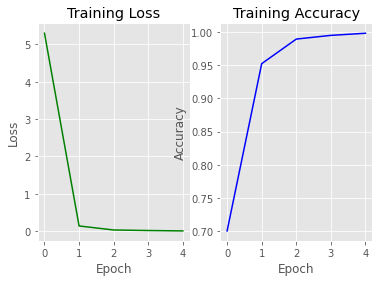

In [ ]:
%%time

model = load_protonet_conv(
    x_dim=(3,256,256), #dimension of input image
    hid_dim=64, #dimension of hidden layer
    z_dim=64, #ddimension of embedded image
    )
#model contains the embedded image

optimizer = optim.Adam(model.parameters(), lr = 0.001)

n_classes = 5
n_support = 5
n_query = 5

train_x = trainx
train_y = trainy

max_epoch = 5
epoch_size = 2000 #EPISODE - A training iteration. We train the network once, calculate loss and backpropogate error

train(model, optimizer, train_x, train_y, n_classes, n_support, n_query, max_epoch, epoch_size)

## Saving and loading the model after training

Saving the model

In [ ]:
model_save = {'model': model,
              'state_dict': model.state_dict(),
              'optimizer' : optimizer.state_dict()}

torch.save(model_save, "/content/drive/MyDrive/ProjectPhase/proto_5class_5ns_5nq_cmutrain_test_final.pth")

Loading the model

In [ ]:
def load_model(filepath):
    loadmodel = torch.load(filepath)
    model = loadmodel['model']
    model.load_state_dict(loadmodel['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    model.eval()
    
    return model

In [ ]:
model = load_model("/content/drive/MyDrive/ProjectPhase/proto_20class_5ns_5nq.pth")
print(model)

ProtoNet(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), st

## Reading test data

In [ ]:
def read_emotions1(emotion_directory_path, emotion_directory_name):
    """
    Reads all the characters from a given alphabet_directory
    """
    data = []
    labels = []
    images = os.listdir(emotion_directory_path)
    for img in images:
      #if (int(img.split(".")[0])<41):
        image = cv2.resize(
            cv2.cvtColor(cv2.imread(emotion_directory_path+img),cv2.COLOR_BGR2RGB),
            (256,256)
             )
        data.append(image)
        labels.append(emotion_directory_name)
        """    #rotations of image
        rotated_90 = ndimage.rotate(image, 90)
        rotated_180 = ndimage.rotate(image, 180)
        rotated_270 = ndimage.rotate(image, 270)
        data.extend((image, rotated_90, rotated_180, rotated_270))
        labels.extend((
                emotion_directory_name + '_0',
                emotion_directory_name + '_90',
                emotion_directory_name + '_180',
                emotion_directory_name + '_270'
            ))"""
    return np.array(data), np.array(labels)

In [ ]:
def read_images1(base_directory):
    """
    Reads all the alphabets from the base_directory
    Uses multithreading to decrease the reading time drastically
    """
    data = None
    labels = None
    pool = mp.Pool(mp.cpu_count())
    results = [pool.apply(read_emotions1,
                          args=(
                              base_directory +'/'+ directory + '/', directory, 
                              )) for directory in os.listdir(base_directory)]
    pool.close()
    #print(results)
    for result in results:
        if data is None:
            data = result[0]
            labels = result[1]
        else:
            data = np.vstack([data, result[0]])
            labels = np.concatenate([labels, result[1]])
    return data, labels

In [ ]:
dir = '/content/drive/MyDrive/ProjectPhase/CMU_Prototypical/test'

In [ ]:
dir = '/content/drive/MyDrive/ProjectPhase/Emotions'

In [ ]:
%%time 
testx, testy = read_images1(dir)

CPU times: user 336 ms, sys: 210 ms, total: 546 ms
Wall time: 1min 45s


In [ ]:
testx.shape,testy.shape

((200, 256, 256, 3), (200,))

## Testing

In [ ]:
def test(model, test_x, test_y, n_classes, n_support, n_query, test_episode):
  """
  Tests the protonet
  Args:
      model: trained model
      test_x (np.array): images of testing set
      test_y (np.array): labels of testing set
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      test_episode (int): number of episodes to test on
  """
  running_loss = 0.0
  running_acc = 0.0
  for episode in tnrange(test_episode):
    sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
    loss, output = model.set_forward_loss(sample)
    running_loss += output['loss']
    running_acc += output['acc']
  avg_loss = running_loss / test_episode
  avg_acc = running_acc / test_episode
  print('Test results -- Loss: {:.4f} Acc: {:.4f}'.format(avg_loss, avg_acc))

In [ ]:
n_classes = 5
n_support = 5
n_query = 5

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 1.3411 Acc: 0.7316


In [ ]:
n_classes = 5
n_support = 5
n_query = 5

test_x = testx
test_y = testy

test_episode = 2000

test(model, test_x, test_y, n_classes, n_support, n_query, test_episode)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app



Test results -- Loss: 5.5315 Acc: 0.4532



## Testing with a sample

In [ ]:
def extract_image2(n_classes, n_support, query, images, labels):
  """
  Picks random sample of size n_support+n_querry, for n_classes classes
  Args:
      n_classes (int): number of classes in a classification task
      n_support (int): number of labeled examples per class in the support set
      n_query (int): number of labeled examples per class in the query set
      images (np.array): dataset of images
      labels (np.array): dataset of labels
  Returns:
      (dict) of:
        (torch.Tensor): sample of images. Size (n_classes, n_support+n_query, (dim))
        (int): n_classes
        (int): n_support
        (int): n_query
  Example: 
        Take n_classes = 5, n_support = 3, n_query = 3
  """
  sample = []
  final_label=[]
  K = np.random.choice(np.unique(labels), n_classes, replace=False) #np.unique(labels)=20 i.e 20 unique classes
  #Hence from 20 classes it randomly choose 5 classes without replacement
  for cls in K:
    final_label.append(cls)
    images_cls = images[labels == cls] #images_cls contains all the images from the particular class(for example all images of e1_90)
    perm = np.random.permutation(images_cls) #reorganises the images in the class
    sample_cls = perm[:(n_support)] #From the 30 images of the class, it extracts 6 images(n_support+n_query)
    #print(sample_cls.shape)
    sample_cls1=np.concatenate((sample_cls, query))
    #print(sample_cls1.shape)
    sample.append(sample_cls1)
    #print(sample.shape)
    # sample list contains 6 images from each of the 5 classes
  sample = np.array(sample)#converts it into a numpy array(ndarray)
  sample = torch.from_numpy(sample).float()#converts the ndarray into a tensor. Tensors are generalised vectors. Similar to multidimensional array
  #sample tensor will have shape (5,6,256,256,3)
  sample = sample.permute(0,1,4,2,3)#rearranges the original tensor according to the designed ordering
  #print(sample.shape)
  #After reordering sample will have shape (5,6,3,256,256)
  return({
      'images': sample,
      'n_classes': n_classes,
      'n_support': n_support,
      'n_query': 1,
      'final_label':final_label
      })

In [ ]:
def display2(sample):
  """
  Displays sample in a grid
  Args:
      sample (torch.Tensor): sample of images to display
  """
  #need 4D tensor to create grid, currently 5D
  sample_4D = sample.view(sample.shape[0]*sample.shape[1],*sample.shape[2:])
  #make a grid
  out = torchvision.utils.make_grid(sample_4D, nrow=sample.shape[1],range=(0,255),normalize=True)
  plt.figure(figsize = (10,10))
  plt.imshow(out.permute(1, 2, 0))

In [ ]:
def read_test_image(test_image_path):
  data1=[]
  image1 = cv2.resize(
            cv2.cvtColor(cv2.imread(test_image_path),cv2.COLOR_BGR2RGB),
            (256,256))#imread reads the image in BGR which is then converted to RGB and resized to (256,256)
  data1.append(image1)
  query=np.array(data1)
  return query

In [ ]:
def predict_test(test_example):
  emotion_dict={"e1":"Anger","e2":"Disgust","e3":"Happy","e4":"Neutral","e5":"Surprise"}
  test_loss, test_output = model.set_forward_loss(test_example)
  test_y_val = test_output['y_hat']
  test_y_pred=[[0 for i in range(len(test_y_val[0]))]for j in range(len(test_y_val))]
  for i in range(len(test_y_val)):
    for j in range(len(test_y_val[0])):
      test_y_pred[i][j]=test_example['final_label'][test_y_val[i][j]]
  return emotion_dict[test_y_pred[0][0]]


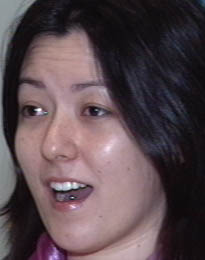

In [ ]:
from google.colab.patches import cv2_imshow
test_image_path = '/content/drive/MyDrive/ProjectPhase/CMU_Prototypical/test/e5/129_02_02_130_05.jpg'
img = cv2.imread(test_image_path)
cv2_imshow(img)

/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


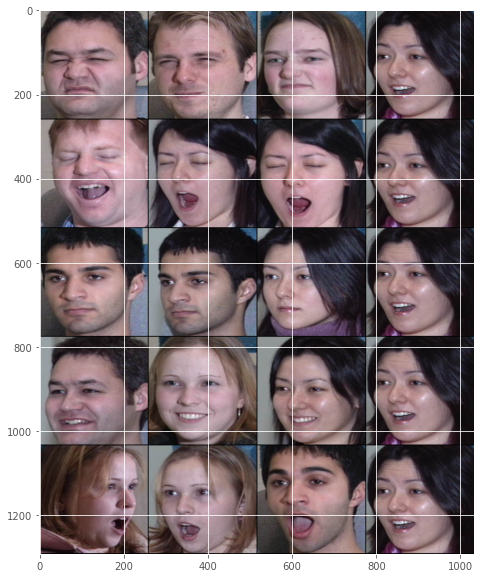

In [ ]:
query = read_test_image(test_image_path)
example1 = extract_image2(5, 3, query, testx, testy)
display2(example1['images'])
#print(example1['final_label'])

In [ ]:
print(predict_test(example1))

Surprise


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import itertools 

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=['Anger', 'Disgust', 'Happy', 'Neutral', 'Surprise']
  PCLASSES=['Surprise', 'Neutral', 'Happy', 'Disgust', 'Anger']
  list_acc=[[0 for i in range(5)] for j in range(5)]
  list_dict={"Anger":1,"Disgust":2,"Happy":3,"Neutral":4,"Surprise":5}
  for i in range(5):
    emotion_directory_path='/content/drive/MyDrive/ProjectPhase/CMU_Prototypical/test/e'+str(i+1)
    images_dir = os.listdir(emotion_directory_path)
    #for j in range(31,41):
    for img in images_dir:
      image = emotion_directory_path+'/'+img
      #test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e'+str(i+1)+'/'+str(j)+'.jpg'
      test_query = read_test_image(image)
      test_example1 = extract_image2(5, 5, test_query, testx, testy)
      prediction=predict_test(test_example1)
      pred=list_dict[prediction]
      list_acc[i][pred-1]+=1
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/30 for i in range(5)] for j in range(5)]
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


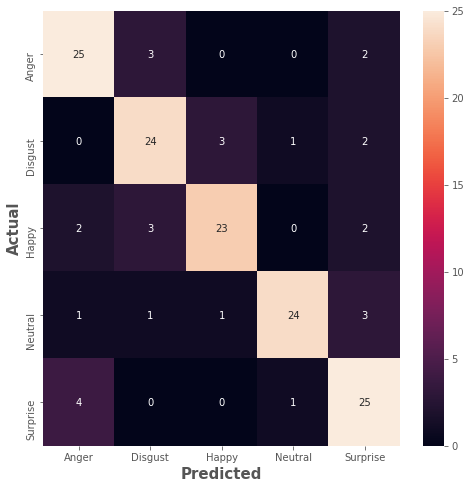

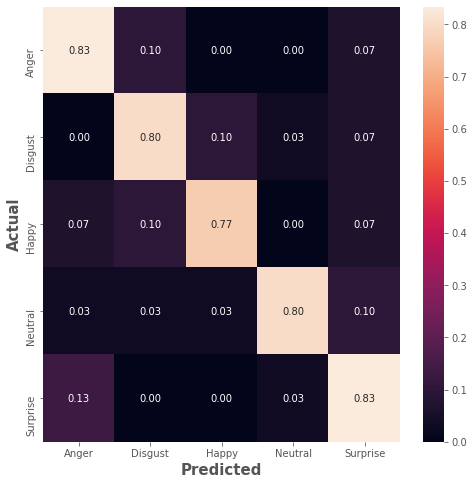

In [ ]:
confusion_matrix(testx,testy)

In [ ]:
def confusion_matrix(testx,testy):
  ACLASSES=['Anger', 'Disgust', 'Happy', 'Neutral', 'Surprise']
  PCLASSES=['Surprise', 'Neutral', 'Happy', 'Disgust', 'Anger']
  list_acc=[[0 for i in range(5)] for j in range(5)]
  list_dict={"Anger":1,"Disgust":2,"Happy":3,"Neutral":4,"Surprise":5}
  for i in range(5):
    for j in range(1,41):
      test_image_path = '/content/drive/MyDrive/ProjectPhase/Emotions/e'+str(i+1)+'/'+str(j)+'.jpg'
      test_query = read_test_image(test_image_path)
      test_example1 = extract_image2(5, 5, test_query, testx, testy)
      prediction=predict_test(test_example1)
      pred=list_dict[prediction]
      list_acc[i][pred-1]+=1
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc,annot=True,fmt='.0f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()
  
  list_acc1 = [[list_acc[j][i]/40 for i in range(5)] for j in range(5)]
  f,ax=plt.subplots(figsize=(8,8))
  sns.heatmap(list_acc1,annot=True,fmt='0.2f')
  ax.set_xlabel('Predicted', fontsize='15', weight='bold')
  ax.set_ylabel('Actual', fontsize='15', weight='bold')
  ax.set_xticklabels(np.unique(ACLASSES), fontsize='medium')
  ax.set_yticklabels(np.unique(PCLASSES), fontsize='medium')
  plt.show()


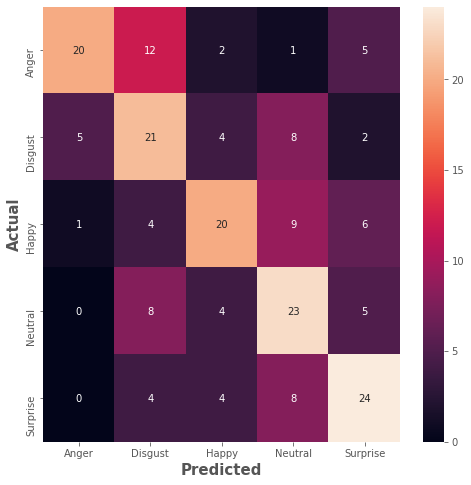

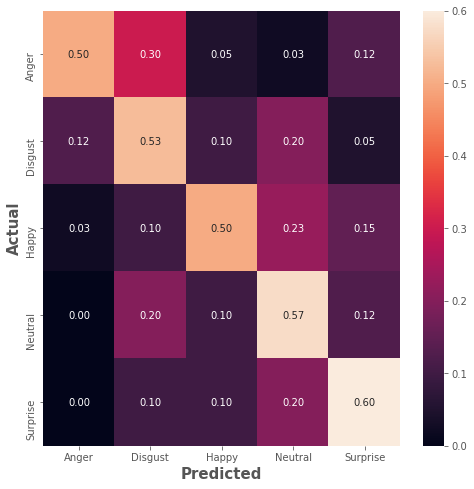

In [ ]:
confusion_matrix(testx,testy)

['e5', 'e2', 'e3', 'e1', 'e4']


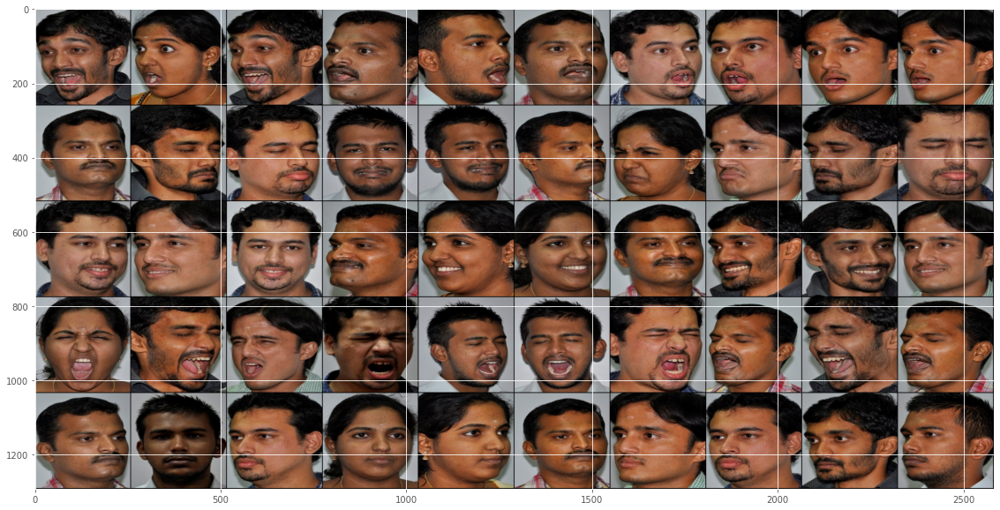

In [ ]:
my_sample = extract_image(n_classes, n_support, n_query, test_x, test_y)
display1(my_sample['images'])
print(my_sample['final_label'])

In [ ]:
my_loss, my_output = model.set_forward_loss(example1)
my_output

{'acc': 0.19999998807907104, 'loss': 4.925145149230957, 'y_hat': tensor([[3],
         [3],
         [3],
         [3],
         [3]], device='cuda:0')}

In [ ]:
y_val = my_output['y_hat']
print(y_val)

tensor([[0],
        [0],
        [0],
        [0],
        [0]], device='cuda:0')


In [ ]:
print(y_val[0])
y_new1=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new1[i][j]=example1['final_label'][i]
print(y_new1)

tensor([0], device='cuda:0')
[['e4'], ['e1'], ['e2'], ['e5'], ['e3']]


In [ ]:
print(y_val[0])
y_new=[[0 for i in range(len(y_val[0]))]for j in range(len(y_val))]
print(len(y_new))
for i in range(len(y_val)):
  for j in range(len(y_val[0])):
    y_new[i][j]=example1['final_label'][y_val[i][j]]
print(y_new)

tensor([0], device='cuda:0')
5
[['e4'], ['e4'], ['e4'], ['e4'], ['e4']]


In [ ]:
my_loss, my_output = model.set_forward_loss(my_sample)

In [ ]:
my_output

{'acc': 0.7199999690055847,
 'loss': 0.6986605525016785,
 'y_hat': tensor([[0, 0, 0, 1, 0],
         [3, 4, 4, 1, 1],
         [2, 2, 2, 2, 0],
         [3, 3, 3, 3, 3],
         [4, 2, 2, 4, 4]], device='cuda:0')}

In [ ]:
print(y_new1)#Actual
print(y_new)#Predicted

[['e3'], ['e2'], ['e5'], ['e1'], ['e4']]
[['e1'], ['e1'], ['e1'], ['e1'], ['e1']]


**Input from webcam as photo**

In [ ]:
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image

<IPython.core.display.Javascript object>

Saved to photo.jpg


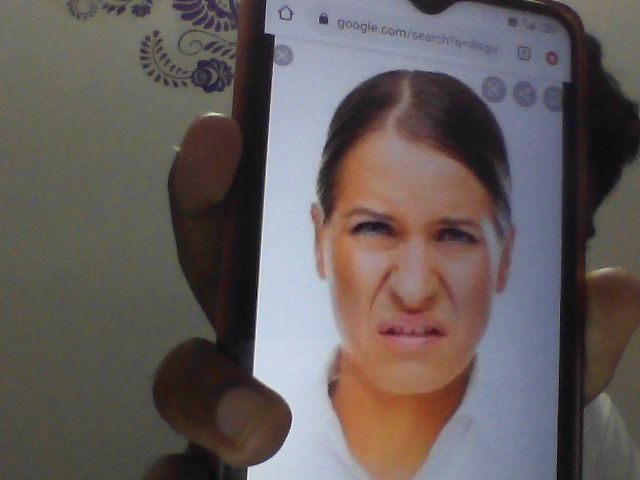

In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
# Read an image
image = cv2.imread('photo.jpg', cv2.IMREAD_COLOR)

# Recognize a facial expression if a face is detected. The boolean argument set to False indicates that the process runs on CPU
fer = cvision.recognize_facial_expression(image, False,False,True)

# Print list of emotions (individual classification from 9 convolutional branches and the ensemble classification)	
print('Individual classification from 9 convolutional branches: ',fer.list_emotion[:-1])
print('Ensemble classification: ',fer.list_emotion[-1])

Individual classification from 9 convolutional branches:  ['Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Disgust', 'Sad']
Ensemble classification:  Disgust
